In [1]:
import numpy as np
from datasets import Dataset,DatasetDict,load_from_disk
import pandas as pd

ind=1
item='Ames Mutagenicity'

data_dict=load_from_disk(f'dataset\cv{ind}_aug')
data_dict=data_dict.select_columns(['smiles',item])


In [2]:
data_dict['test']=load_from_disk('test')

train=data_dict['train'].to_pandas()

In [3]:
# import pandas as pd
# from datasets import Dataset
# item='Ames Mutagenicity'
# data=pd.read_csv('smiles_cas_N6512.csv',header=None, delimiter=' 	',engine='python')
# data.columns=['smiles','id',item]
# dataset=Dataset.from_pandas(data)
# data_dict=dataset.train_test_split(test_size=0.1)
# data_dict['val']=data_dict['test']
# data_dict

In [4]:
import torch
from transformers import GPT2Tokenizer, GPT2Model, GPT2Config, Trainer, TrainingArguments,GPT2DoubleHeadsModel,GPT2PreTrainedModel,GPT2ForSequenceClassification
from datasets import load_dataset

# 定义标记器和模型配置
tokenizer = GPT2Tokenizer.from_pretrained(r"D:\system\桌面\lcm-code\tokenizers_lcm\tokenizer_gpt100.json")
tokenizer.pad_token = tokenizer.eos_token
tokenizer.pad_token_id

100

In [5]:
from torch import nn
from transformers import AutoModelForSequenceClassification,GPT2ForSequenceClassification,GPT2Config
from torch.nn.utils import prune
class GPT2cls(nn.Module):
    def __init__(self,drop,purn,n_block):
        super(GPT2cls, self).__init__()
        self.config = GPT2Config.from_pretrained('D:\system\桌面\lcm-code\pre_training\chem_gpt100')  #  使用预训练的GPT2模型
        self.config.pad_token_id=tokenizer.pad_token_id
        self.config.num_labels=2
        self.config.num_attention_heads=4
        self.config.num_hidden_layers=n_block
        self.config.hidden_size=512
        self.model = AutoModelForSequenceClassification.from_config(self.config)
        for name, module in self.model.named_modules():
            if isinstance(module, (nn.Dropout, nn.Dropout2d, nn.Dropout3d)):
                module.p = drop
        for name, module in self.model.named_modules():
            if isinstance(module, torch.nn.Linear):
                prune.l1_unstructured(module, name='weight', amount=purn)
    def forward(self, input_ids, attention_mask):
        outputs = self.model(input_ids=input_ids,attention_mask=attention_mask)
        return outputs




In [6]:
tokenized_dataset = data_dict.map(
    lambda element: tokenizer(element['smiles']),batched=True
)


In [7]:
tokenized_dataset=tokenized_dataset.select_columns(['input_ids','attention_mask',item])

In [8]:
tokenized_dataset

DatasetDict({
    train: Dataset({
        features: ['input_ids', 'attention_mask', 'Ames Mutagenicity'],
        num_rows: 10559
    })
    val: Dataset({
        features: ['input_ids', 'attention_mask', 'Ames Mutagenicity'],
        num_rows: 586
    })
    test: Dataset({
        features: ['input_ids', 'attention_mask', 'Ames Mutagenicity'],
        num_rows: 652
    })
})

In [9]:

from transformers import DataCollatorWithPadding
from torch.utils.data import DataLoader

data_collator = DataCollatorWithPadding(tokenizer=tokenizer)
tokenized_dataset.set_format("torch")


eval_dataloader = DataLoader(tokenized_dataset["val"], batch_size=20,collate_fn=data_collator)
test_dataloader=DataLoader(tokenized_dataset['test'],batch_size=20,collate_fn=data_collator)
train_dataloader=DataLoader(tokenized_dataset["train"], batch_size=40,collate_fn=data_collator,shuffle=True)

In [10]:
from torch.optim import AdamW
import torch.nn as nn
from transformers import get_scheduler

gradient_accumulation_steps=20
# optimizer = AdamW(model.parameters(), lr=5e-4)


criterion = nn.CrossEntropyLoss()
num_train_epochs = 150
num_update_steps_per_epoch = len(train_dataloader)
num_training_steps = num_train_epochs * num_update_steps_per_epoch/gradient_accumulation_steps

# lr_scheduler = get_scheduler(
#     name="cosine",
#     optimizer=optimizer,
#     num_warmup_steps=300,
#     num_training_steps=num_training_steps,
# )

In [11]:
from accelerate import Accelerator
Accelerator.mixed_precision == 'fp16'
accelerator = Accelerator()

#
eval_dataloader,test_dataloader,train_dataloader = accelerator.prepare(
     eval_dataloader,test_dataloader,train_dataloader)
# )

In [12]:
from sklearn.metrics import balanced_accuracy_score
import torch
def caculate_loss(loader,model):
    losses=[]
    model.eval()
    for batch in loader:
        with torch.no_grad():
            labels = batch[item].to(torch.int64)
            # batch['input_ids']=batch['input_ids'].to(torch.int64)
            logits = model(input_ids=batch['input_ids'],attention_mask=batch['attention_mask']).logits
            loss = criterion(logits, labels)
            losses.append(loss.unsqueeze(dim=0))
    torch.cuda.empty_cache()
    return torch.mean(torch.cat(losses,dim=0))

In [13]:
from sklearn.metrics import balanced_accuracy_score
def acc(loader,model):
    predicts=[]
    labels=[]
    model.eval()
    for batch in loader:
        with torch.no_grad():
            label = batch[item].to(torch.int64)
            # batch['input_ids']=batch['input_ids'].to(torch.int64)
            logits = model(input_ids=batch['input_ids'],attention_mask=batch['attention_mask']).logits

            predict=torch.argmax(logits,dim=1)
            predicts.append(predict.flatten().cpu().numpy())
            labels.append(label.flatten().cpu().numpy())

    predicts=np.concatenate(predicts)
    labels=np.concatenate(labels)
    torch.cuda.empty_cache()
    return (predicts==labels).sum()/len(labels)

In [14]:
from matplotlib import pyplot as plt
from tqdm.notebook import tqdm
import optuna
from collections import defaultdict
plt.style.use('ggplot')
plt.rcParams['font.family'] = 'Times New Roman'

def objective(trial):
    # Generate the model.

    num_blocks=trial.suggest_int("num_blocks", 2,6)
    dropout=trial.suggest_float("dropout", 0.1, 0.3)
    purn=trial.suggest_float("purns",0.1,0.3)

    model = GPT2cls(dropout,purn,num_blocks)


    # Generate the optimizers.
    lr = trial.suggest_float("lr", 1e-5, 1e-4, log=True)
    optimizer = AdamW(model.parameters(), lr=lr)
    lr_scheduler = get_scheduler(
    name="cosine",
    optimizer=optimizer,
    num_warmup_steps=300,
    num_training_steps=num_training_steps)

    model,optimizer=accelerator.prepare(model,optimizer)
    num_train_epochs=trial.suggest_int('epochs',100,200)

    completed_steps = 1

    scaler = torch.cuda.amp.GradScaler()

    train_accs=[]
    eval_accs=[]
    train_losses=[]
    eval_losses=[]
    for epoch in tqdm(range(num_train_epochs),total=num_train_epochs):

        model.train()
        for step,batch in enumerate(train_dataloader):

            labels = batch[item].to(torch.int64)

            logits = model(input_ids=batch['input_ids'],attention_mask=batch['attention_mask']).logits


            loss = criterion(logits, labels)

            loss=loss/gradient_accumulation_steps
            scaler.scale(loss).backward()
            if step % gradient_accumulation_steps==0:
                # accelerator.clip_grad_norm_(model.parameters(), 1.0)
                scaler.step(optimizer)
                lr_scheduler.step()
                optimizer.zero_grad()
                completed_steps += 1
                torch.cuda.empty_cache()
                scaler.update()

        eval_acc=acc(eval_dataloader,model)
        train_acc=acc(train_dataloader,model)
        train_accs.append(train_acc)
        eval_accs.append(eval_acc)

        train_losse=caculate_loss(train_dataloader,model)
        eval_losse=caculate_loss(eval_dataloader,model)
        train_losses.append(train_losse.cpu().numpy())
        eval_losses.append(eval_losse.cpu().numpy())

        tqdm.write(f'train_acc{train_acc}  eval_acc{eval_acc}')
        torch.cuda.empty_cache()

    fig, ax1 = plt.subplots(figsize=(10, 6))

    # 绘制 accuracy
    ax1.plot(range(num_train_epochs), train_accs, label='Train Acc', marker='o')
    ax1.plot(range(num_train_epochs), eval_accs, label='Eval Acc', marker='o')
    ax1.fill_between(range(num_train_epochs), train_accs, eval_accs, color='gray', alpha=0.1)
    ax1.set_xlabel('Epochs', fontsize=10)
    ax1.set_ylabel('Accuracy', fontsize=10)
    ax1.set_title('Train and Eval Accuracy Over Epochs', fontsize=16)
    ax1.legend(loc='upper left', fontsize=10)

    # 创建第二个 y 轴并绘制 loss
    ax2 = ax1.twinx()
    ax2.plot(range(num_train_epochs), train_losses, label='Train Loss', color='red', linestyle='--', marker='x')
    ax2.plot(range(num_train_epochs), eval_losses, label='Eval Loss', color='blue', linestyle='--', marker='x')
    ax2.set_ylabel('Loss', fontsize=10)
    ax2.legend(loc='lower right', fontsize=10)

    plt.grid(True)
    plt.tight_layout()
    plt.gcf().set_dpi(300)
    plt.show()

    del model
    del optimizer

    if trial.should_prune():
        raise optuna.exceptions.TrialPruned()


    return max(eval_accs)

[I 2024-04-28 19:13:19,891] A new study created in memory with name: no-name-da676297-d2a4-481c-99d0-e5afd6d4ff93


  0%|          | 0/182 [00:00<?, ?it/s]

train_acc0.4985320579600341  eval_acc0.5358361774744027
train_acc0.5770432806136945  eval_acc0.5819112627986348
train_acc0.606212709536888  eval_acc0.6092150170648464
train_acc0.6243015437067904  eval_acc0.6348122866894198
train_acc0.6515768538687375  eval_acc0.6723549488054608
train_acc0.6572592101524766  eval_acc0.689419795221843
train_acc0.6699498058528269  eval_acc0.6911262798634812
train_acc0.6754427502604413  eval_acc0.7013651877133106
train_acc0.6791362818448716  eval_acc0.7030716723549488
train_acc0.6844398143763614  eval_acc0.71160409556314
train_acc0.6837768728099252  eval_acc0.71160409556314
train_acc0.6910692300407235  eval_acc0.7081911262798635
train_acc0.695709821005777  eval_acc0.7167235494880546
train_acc0.6972251160147741  eval_acc0.7252559726962458
train_acc0.7036651198030116  eval_acc0.7201365187713311
train_acc0.707074533573255  eval_acc0.7337883959044369
train_acc0.710673359219623  eval_acc0.7286689419795221
train_acc0.7090633582725637  eval_acc0.7389078498293515
t

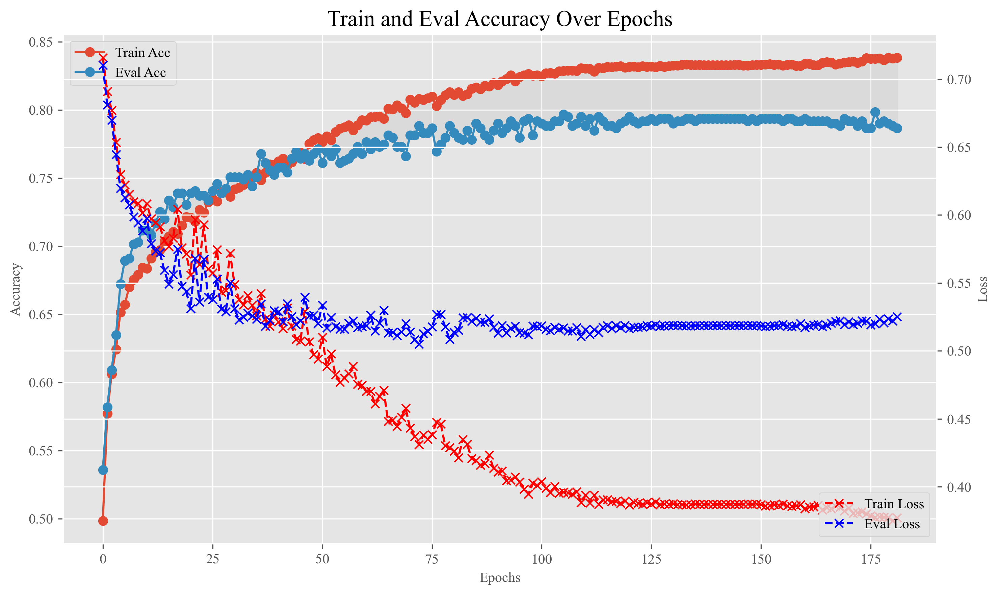

[I 2024-04-28 19:45:48,236] Trial 0 finished with value: 0.7986348122866894 and parameters: {'num_blocks': 3, 'dropout': 0.269153554030959, 'purns': 0.17787973394515766, 'lr': 1.4618755657584225e-05, 'epochs': 182}. Best is trial 0 with value: 0.7986348122866894.


  0%|          | 0/170 [00:00<?, ?it/s]

train_acc0.6028032957666446  eval_acc0.6023890784982935
train_acc0.6401174353631973  eval_acc0.6518771331058021
train_acc0.6641727436310256  eval_acc0.6928327645051194
train_acc0.6778103987119992  eval_acc0.6996587030716723
train_acc0.6853868737569846  eval_acc0.7098976109215017
train_acc0.6853868737569846  eval_acc0.7218430034129693
train_acc0.6981721753953973  eval_acc0.7218430034129693
train_acc0.7053698266881333  eval_acc0.7098976109215017
train_acc0.6999715882185813  eval_acc0.7286689419795221
train_acc0.7048015910597595  eval_acc0.7303754266211604
train_acc0.7200492470877924  eval_acc0.7372013651877133
train_acc0.7213751302206648  eval_acc0.7201365187713311
train_acc0.7269627805663416  eval_acc0.7252559726962458
train_acc0.7230798371057865  eval_acc0.7252559726962458
train_acc0.7339710199829529  eval_acc0.7303754266211604
train_acc0.7417369069040629  eval_acc0.7303754266211604
train_acc0.7353916090538877  eval_acc0.735494880546075
train_acc0.7515863244625438  eval_acc0.7525597269

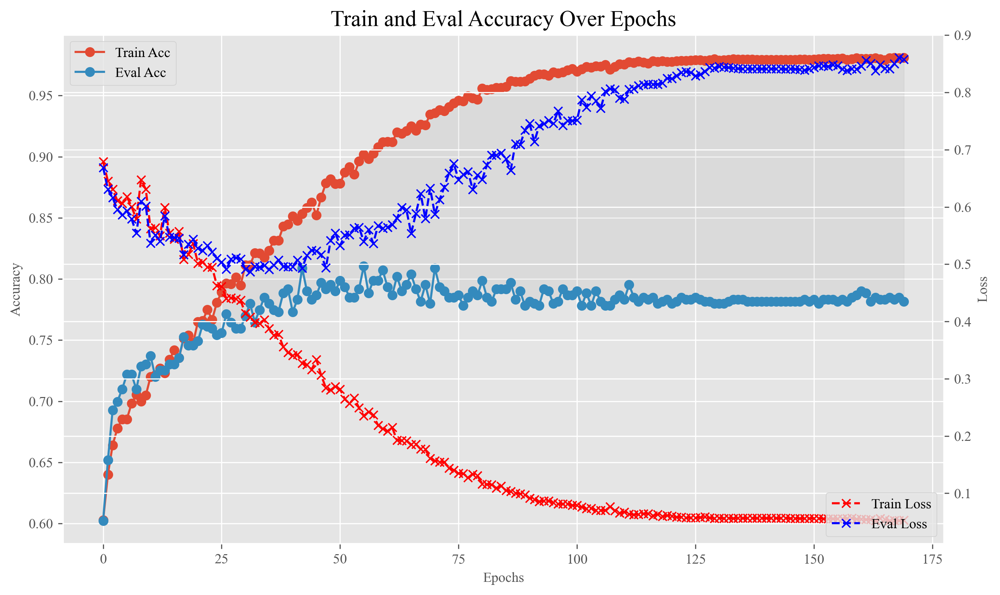

[I 2024-04-28 20:30:12,659] Trial 1 finished with value: 0.810580204778157 and parameters: {'num_blocks': 5, 'dropout': 0.2866486653896074, 'purns': 0.24184322878571224, 'lr': 5.901535674280178e-05, 'epochs': 170}. Best is trial 1 with value: 0.810580204778157.


  0%|          | 0/169 [00:00<?, ?it/s]

train_acc0.5557344445496732  eval_acc0.5750853242320819
train_acc0.6046974145278909  eval_acc0.5972696245733788
train_acc0.6246803674590397  eval_acc0.6416382252559727
train_acc0.6497774410455536  eval_acc0.674061433447099
train_acc0.6601950942324084  eval_acc0.6945392491467577
train_acc0.6685292167818923  eval_acc0.6962457337883959
train_acc0.6751586324462544  eval_acc0.7150170648464164
train_acc0.6797992234113079  eval_acc0.7133105802047781
train_acc0.6854815796950469  eval_acc0.7184300341296929
train_acc0.6884174637749787  eval_acc0.71160409556314
train_acc0.6976039397670234  eval_acc0.71160409556314
train_acc0.7029074722985131  eval_acc0.7133105802047781
train_acc0.7042333554313855  eval_acc0.7167235494880546
train_acc0.703475707926887  eval_acc0.7235494880546075
train_acc0.7119992423524955  eval_acc0.71160409556314
train_acc0.7092527701486884  eval_acc0.7286689419795221
train_acc0.71872336395492  eval_acc0.7235494880546075
train_acc0.7147457145563026  eval_acc0.7252559726962458
tr

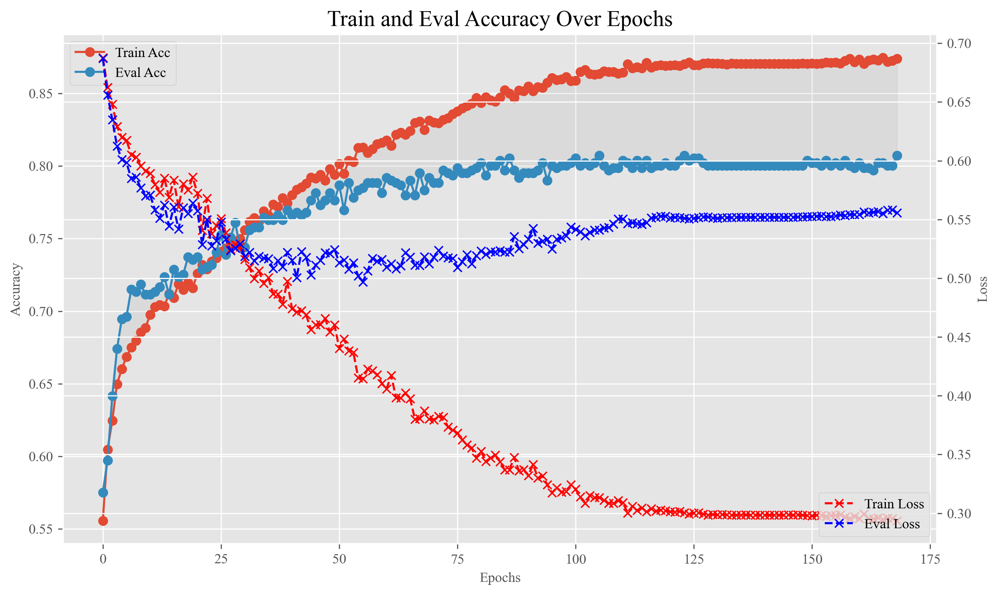

[I 2024-04-28 21:05:55,673] Trial 2 finished with value: 0.8071672354948806 and parameters: {'num_blocks': 4, 'dropout': 0.2204430578601197, 'purns': 0.275286242015672, 'lr': 1.3396844505821705e-05, 'epochs': 169}. Best is trial 1 with value: 0.810580204778157.


  0%|          | 0/190 [00:00<?, ?it/s]

train_acc0.5737285727815133  eval_acc0.6177474402730375
train_acc0.6083909461123213  eval_acc0.6040955631399317
train_acc0.6081068282981343  eval_acc0.6245733788395904
train_acc0.6494933232313667  eval_acc0.6774744027303754
train_acc0.6635098020645894  eval_acc0.6808873720136519
train_acc0.6762951037030022  eval_acc0.6962457337883959
train_acc0.6779051046500616  eval_acc0.7013651877133106
train_acc0.6874704043943555  eval_acc0.6996587030716723
train_acc0.6929633488019699  eval_acc0.7133105802047781
train_acc0.6940051141206554  eval_acc0.7150170648464164
train_acc0.7008239416611421  eval_acc0.7133105802047781
train_acc0.6963727625722133  eval_acc0.7252559726962458
train_acc0.7071692395113174  eval_acc0.7252559726962458
train_acc0.7069798276351927  eval_acc0.7337883959044369
train_acc0.7076427692016289  eval_acc0.7320819112627986
train_acc0.7096315939009376  eval_acc0.726962457337884
train_acc0.722038071787101  eval_acc0.7457337883959044
train_acc0.722038071787101  eval_acc0.730375426621

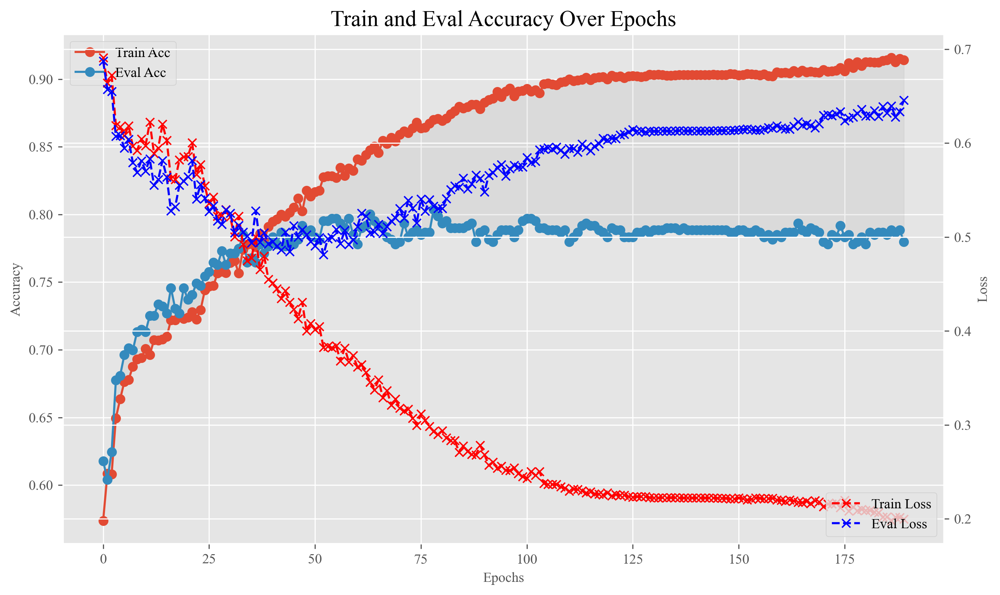

[I 2024-04-28 21:46:05,912] Trial 3 finished with value: 0.8037542662116041 and parameters: {'num_blocks': 4, 'dropout': 0.28198128723173144, 'purns': 0.12159754477963487, 'lr': 2.739189310630209e-05, 'epochs': 190}. Best is trial 1 with value: 0.810580204778157.


  0%|          | 0/199 [00:00<?, ?it/s]

train_acc0.5533667960981153  eval_acc0.5460750853242321
train_acc0.605928591722701  eval_acc0.6143344709897611
train_acc0.6284686049815323  eval_acc0.6313993174061433
train_acc0.660384506108533  eval_acc0.6825938566552902
train_acc0.6604792120465953  eval_acc0.6757679180887372
train_acc0.6727909839946965  eval_acc0.6877133105802048
train_acc0.682545695615115  eval_acc0.6962457337883959
train_acc0.6870915806421063  eval_acc0.7030716723549488
train_acc0.6872809925182309  eval_acc0.7047781569965871
train_acc0.699876882280519  eval_acc0.7133105802047781
train_acc0.6976039397670234  eval_acc0.7184300341296929
train_acc0.7060327682545695  eval_acc0.7218430034129693
train_acc0.7064115920068188  eval_acc0.7218430034129693
train_acc0.7118098304763709  eval_acc0.7235494880546075
train_acc0.713325125485368  eval_acc0.7235494880546075
train_acc0.7136092432995549  eval_acc0.7337883959044369
train_acc0.7229851311677242  eval_acc0.7337883959044369
train_acc0.724405720238659  eval_acc0.737201365187713

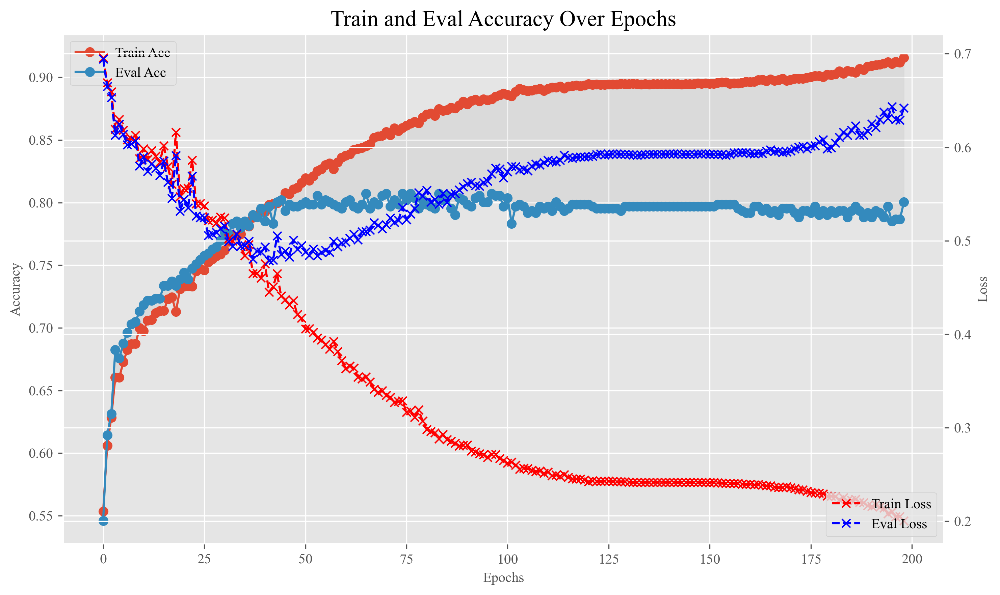

[I 2024-04-28 22:12:00,654] Trial 4 finished with value: 0.8071672354948806 and parameters: {'num_blocks': 2, 'dropout': 0.2614408990330683, 'purns': 0.15810333572655483, 'lr': 3.141572225361268e-05, 'epochs': 199}. Best is trial 1 with value: 0.810580204778157.


  0%|          | 0/150 [00:00<?, ?it/s]

train_acc0.5747703381001988  eval_acc0.5972696245733788
train_acc0.5989203523060896  eval_acc0.6126279863481229
train_acc0.617293304290179  eval_acc0.6228668941979523
train_acc0.6525239132493608  eval_acc0.6689419795221843
train_acc0.6640780376929634  eval_acc0.6791808873720137
train_acc0.6664456861445213  eval_acc0.6843003412969283
train_acc0.6787574580926224  eval_acc0.6843003412969283
train_acc0.6906904062884743  eval_acc0.6928327645051194
train_acc0.7006345297850175  eval_acc0.7047781569965871
train_acc0.7067904157590681  eval_acc0.7218430034129693
train_acc0.7122833601666825  eval_acc0.7286689419795221
train_acc0.7137039492376172  eval_acc0.7337883959044369
train_acc0.7121886542286201  eval_acc0.735494880546075
train_acc0.7247845439909082  eval_acc0.7406143344709898
train_acc0.7280992518230893  eval_acc0.7389078498293515
train_acc0.7330239606023298  eval_acc0.7440273037542662
train_acc0.7366227862486978  eval_acc0.7525597269624573
train_acc0.7434416137891846  eval_acc0.75426621160

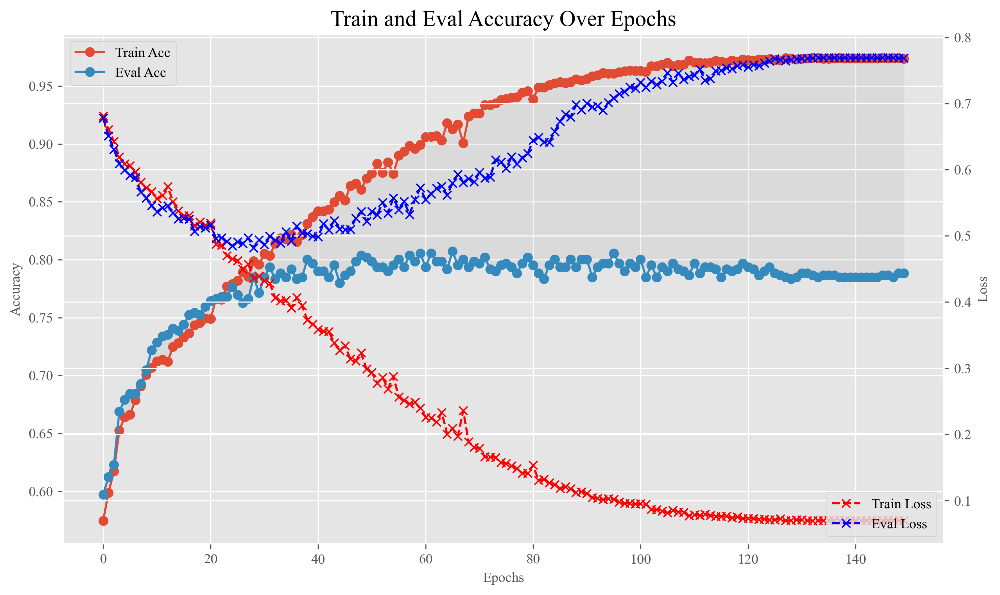

[I 2024-04-28 22:44:46,205] Trial 5 finished with value: 0.8071672354948806 and parameters: {'num_blocks': 4, 'dropout': 0.13755353325367214, 'purns': 0.13957766288478668, 'lr': 1.6518031646594697e-05, 'epochs': 150}. Best is trial 1 with value: 0.810580204778157.


  0%|          | 0/151 [00:00<?, ?it/s]

train_acc0.5714556302680178  eval_acc0.5733788395904437
train_acc0.6090538876787575  eval_acc0.6245733788395904
train_acc0.6366133156548915  eval_acc0.6382252559726962
train_acc0.6563121507718533  eval_acc0.6672354948805461
train_acc0.6667298039587082  eval_acc0.6723549488054608
train_acc0.6719386305521357  eval_acc0.6791808873720137
train_acc0.6845345203144237  eval_acc0.6962457337883959
train_acc0.6847239321905484  eval_acc0.6962457337883959
train_acc0.697793351643148  eval_acc0.7047781569965871
train_acc0.6985509991476465  eval_acc0.6979522184300341
train_acc0.7109574770338101  eval_acc0.7098976109215017
train_acc0.7122833601666825  eval_acc0.7201365187713311
train_acc0.7176815986362345  eval_acc0.7303754266211604
train_acc0.7221327777251634  eval_acc0.7320819112627986
train_acc0.7063168860687565  eval_acc0.726962457337884
train_acc0.7247845439909082  eval_acc0.7320819112627986
train_acc0.7308457240268965  eval_acc0.7303754266211604
train_acc0.7366227862486978  eval_acc0.74061433447

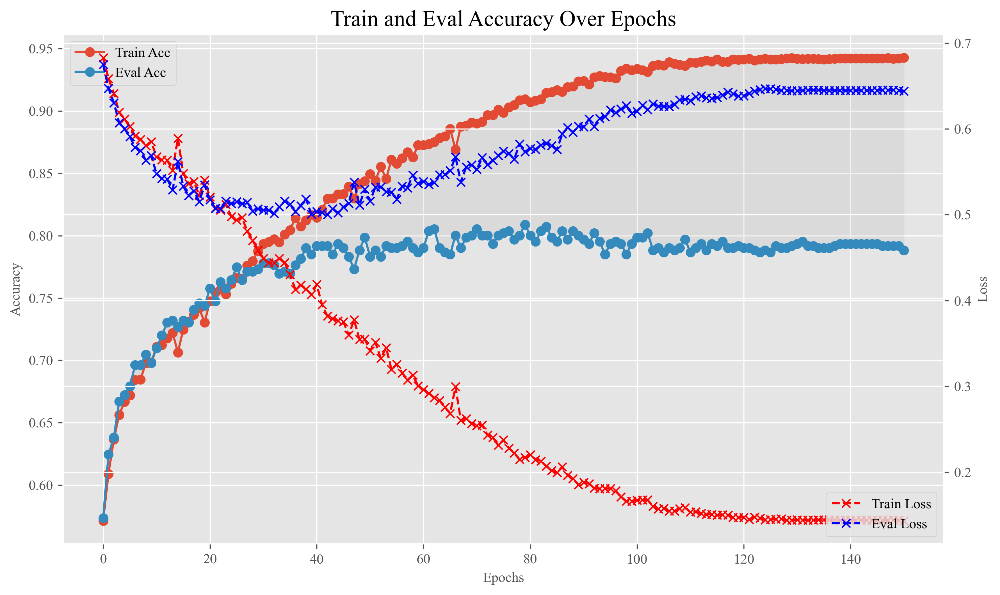

[I 2024-04-28 23:17:44,575] Trial 6 finished with value: 0.8088737201365188 and parameters: {'num_blocks': 4, 'dropout': 0.15896437081471732, 'purns': 0.21181549839627822, 'lr': 1.4772897529225757e-05, 'epochs': 151}. Best is trial 1 with value: 0.810580204778157.


  0%|          | 0/188 [00:00<?, ?it/s]

train_acc0.6022350601382707  eval_acc0.6296928327645052
train_acc0.656785680462165  eval_acc0.6825938566552902
train_acc0.6604792120465953  eval_acc0.6843003412969283
train_acc0.6817880481106166  eval_acc0.6928327645051194
train_acc0.6965621744483379  eval_acc0.7081911262798635
train_acc0.7047068851216971  eval_acc0.7218430034129693
train_acc0.7172080689459229  eval_acc0.7286689419795221
train_acc0.7271521924424661  eval_acc0.7252559726962458
train_acc0.7173027748839852  eval_acc0.7167235494880546
train_acc0.737285727815134  eval_acc0.7320819112627986
train_acc0.7388957287621933  eval_acc0.7320819112627986
train_acc0.7495027938251728  eval_acc0.7542662116040956
train_acc0.755848091675348  eval_acc0.7491467576791809
train_acc0.756416327303722  eval_acc0.7457337883959044
train_acc0.7617198598352116  eval_acc0.764505119453925
train_acc0.7752628089781229  eval_acc0.757679180887372
train_acc0.7890898759352212  eval_acc0.78839590443686
train_acc0.7799981058812387  eval_acc0.757679180887372
t

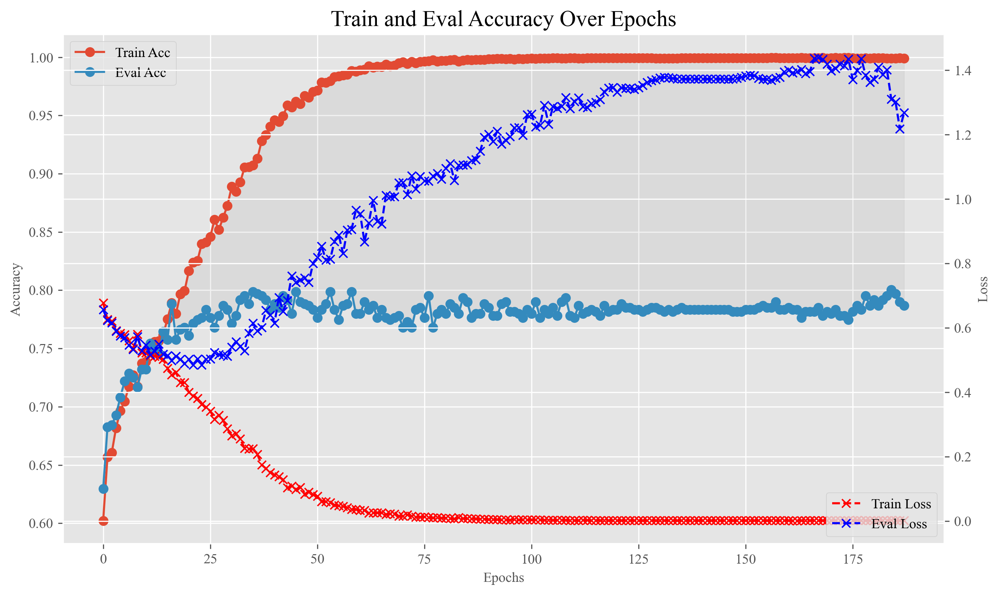

[I 2024-04-29 00:17:09,121] Trial 7 finished with value: 0.8003412969283277 and parameters: {'num_blocks': 6, 'dropout': 0.16407367113725824, 'purns': 0.19294977771890598, 'lr': 6.377697090698395e-05, 'epochs': 188}. Best is trial 1 with value: 0.810580204778157.


  0%|          | 0/194 [00:00<?, ?it/s]

train_acc0.6049815323420779  eval_acc0.6075085324232082
train_acc0.6496827351074912  eval_acc0.6621160409556314
train_acc0.6623733308078417  eval_acc0.689419795221843
train_acc0.6819774599867412  eval_acc0.7098976109215017
train_acc0.6927739369258452  eval_acc0.7133105802047781
train_acc0.7020551188559523  eval_acc0.7286689419795221
train_acc0.7113363007860593  eval_acc0.7286689419795221
train_acc0.7174921867601098  eval_acc0.7320819112627986
train_acc0.7225116014774127  eval_acc0.7389078498293515
train_acc0.7273416043185907  eval_acc0.7474402730375427
train_acc0.728288663699214  eval_acc0.7474402730375427
train_acc0.7307510180888341  eval_acc0.735494880546075
train_acc0.739369258452505  eval_acc0.7337883959044369
train_acc0.7500710294535468  eval_acc0.7525597269624573
train_acc0.7459986741168672  eval_acc0.7372013651877133
train_acc0.7416422009660005  eval_acc0.7491467576791809
train_acc0.7617198598352116  eval_acc0.7610921501706485
train_acc0.7615304479590871  eval_acc0.7525597269624

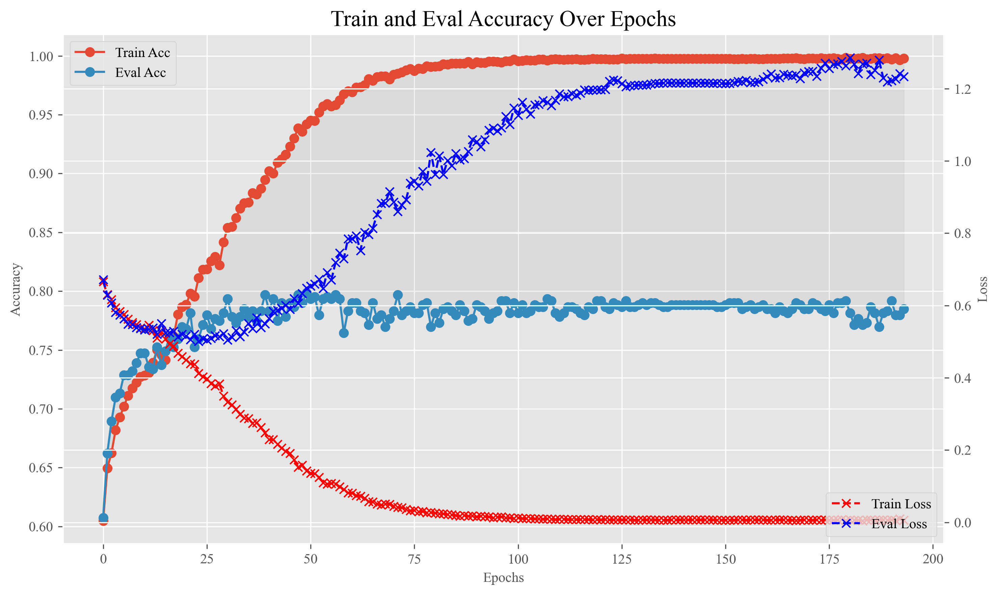

[I 2024-04-29 01:07:44,761] Trial 8 finished with value: 0.7986348122866894 and parameters: {'num_blocks': 5, 'dropout': 0.1543470273524802, 'purns': 0.24312265984998807, 'lr': 3.377558837434931e-05, 'epochs': 194}. Best is trial 1 with value: 0.810580204778157.


  0%|          | 0/151 [00:00<?, ?it/s]

train_acc0.5374561985036462  eval_acc0.552901023890785
train_acc0.5943744672790984  eval_acc0.5972696245733788
train_acc0.6054550620323894  eval_acc0.6228668941979523
train_acc0.6446633203901885  eval_acc0.6569965870307167
train_acc0.6565962685860404  eval_acc0.6757679180887372
train_acc0.6685292167818923  eval_acc0.7030716723549488
train_acc0.671465100861824  eval_acc0.6996587030716723
train_acc0.6676768633393314  eval_acc0.6996587030716723
train_acc0.6887015815891656  eval_acc0.7098976109215017
train_acc0.6908798181645989  eval_acc0.71160409556314
train_acc0.6898380528459135  eval_acc0.71160409556314
train_acc0.7036651198030116  eval_acc0.7235494880546075
train_acc0.7090633582725637  eval_acc0.735494880546075
train_acc0.7065062979448812  eval_acc0.7235494880546075
train_acc0.7047068851216971  eval_acc0.7303754266211604
train_acc0.7158821858130505  eval_acc0.7389078498293515
train_acc0.7211857183445401  eval_acc0.7372013651877133
train_acc0.7235533667960982  eval_acc0.7389078498293515

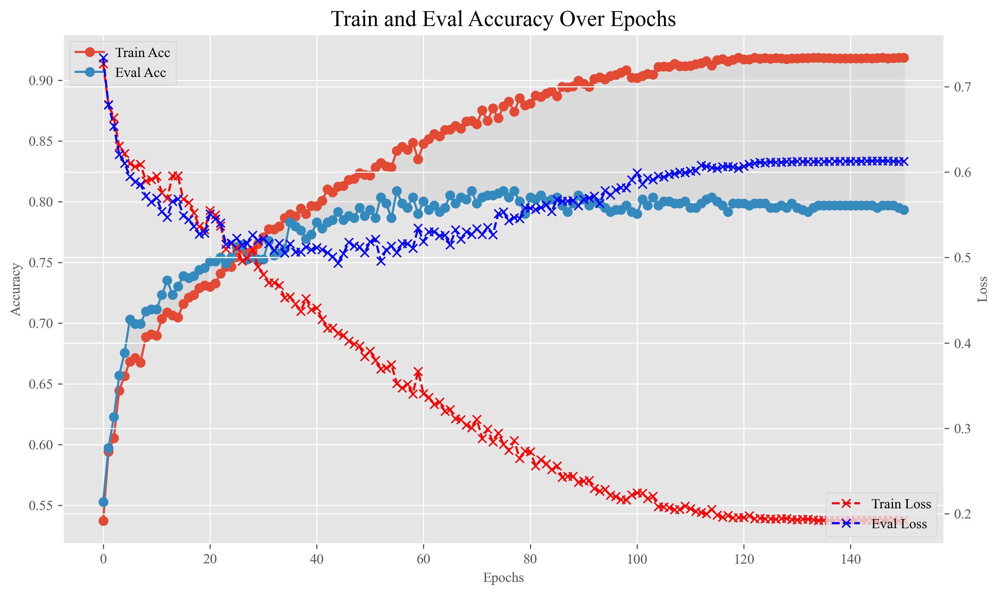

[I 2024-04-29 01:58:56,711] Trial 9 finished with value: 0.8088737201365188 and parameters: {'num_blocks': 6, 'dropout': 0.19281329527320784, 'purns': 0.11608341859134118, 'lr': 1.3185072104628236e-05, 'epochs': 151}. Best is trial 1 with value: 0.810580204778157.


  0%|          | 0/108 [00:00<?, ?it/s]

train_acc0.6104744767496922  eval_acc0.6075085324232082
train_acc0.6587745051614736  eval_acc0.6689419795221843
train_acc0.671749218676011  eval_acc0.6911262798634812
train_acc0.681314518420305  eval_acc0.689419795221843
train_acc0.6913533478549105  eval_acc0.7064846416382252
train_acc0.7006345297850175  eval_acc0.7218430034129693
train_acc0.6976986457050857  eval_acc0.7218430034129693
train_acc0.7035704138649493  eval_acc0.7286689419795221
train_acc0.7163557155033621  eval_acc0.7303754266211604
train_acc0.7125674779808694  eval_acc0.7320819112627986
train_acc0.7272468983805285  eval_acc0.7389078498293515
train_acc0.7275310161947154  eval_acc0.7440273037542662
train_acc0.7391798465763804  eval_acc0.7508532423208191
train_acc0.742683966284686  eval_acc0.742320819112628
train_acc0.7500710294535468  eval_acc0.7474402730375427
train_acc0.7495974997632352  eval_acc0.7627986348122867
train_acc0.7571739748082205  eval_acc0.7696245733788396
train_acc0.7624775073397102  eval_acc0.76279863481228

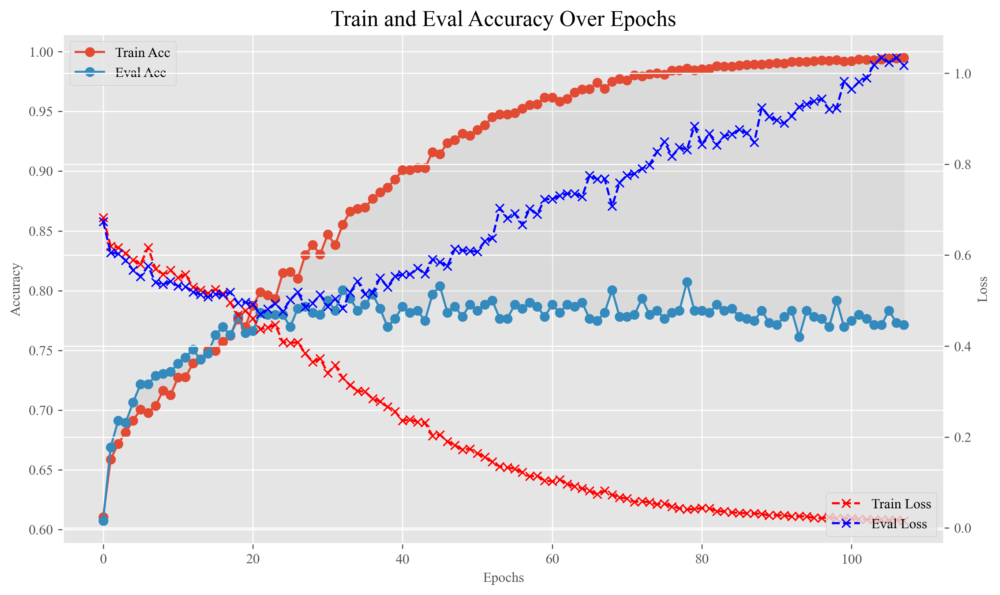

[I 2024-04-29 02:27:09,780] Trial 10 finished with value: 0.8071672354948806 and parameters: {'num_blocks': 5, 'dropout': 0.2301413991915847, 'purns': 0.29593905616391897, 'lr': 6.512384211654558e-05, 'epochs': 108}. Best is trial 1 with value: 0.810580204778157.


  0%|          | 0/146 [00:00<?, ?it/s]

train_acc0.6195662468036746  eval_acc0.6143344709897611
train_acc0.6707074533573255  eval_acc0.6672354948805461
train_acc0.6841556965621745  eval_acc0.6979522184300341
train_acc0.6928686428639076  eval_acc0.7047781569965871
train_acc0.7054645326261957  eval_acc0.7167235494880546
train_acc0.7110521829718723  eval_acc0.726962457337884
train_acc0.7307510180888341  eval_acc0.7389078498293515
train_acc0.7416422009660005  eval_acc0.7337883959044369
train_acc0.742968084098873  eval_acc0.7389078498293515
train_acc0.7624775073397102  eval_acc0.7491467576791809
train_acc0.7690122170660101  eval_acc0.7593856655290102
train_acc0.7729898664646273  eval_acc0.7627986348122867
train_acc0.7906051709442182  eval_acc0.7696245733788396
train_acc0.7989392934937021  eval_acc0.7849829351535836
train_acc0.8147551851501089  eval_acc0.7491467576791809
train_acc0.8170281276636046  eval_acc0.773037542662116
train_acc0.8214793067525333  eval_acc0.773037542662116
train_acc0.8385263756037503  eval_acc0.7781569965870

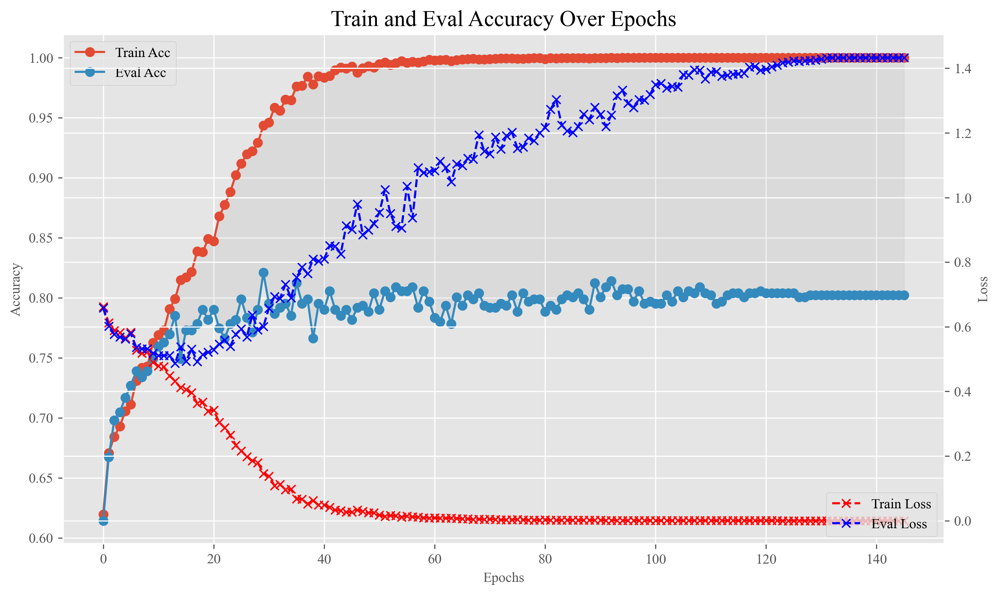

[I 2024-04-29 03:05:14,287] Trial 11 finished with value: 0.8208191126279863 and parameters: {'num_blocks': 5, 'dropout': 0.11306778439245493, 'purns': 0.22076311623130024, 'lr': 8.94832850889719e-05, 'epochs': 146}. Best is trial 11 with value: 0.8208191126279863.


  0%|          | 0/129 [00:00<?, ?it/s]

train_acc0.6151150677147457  eval_acc0.6194539249146758
train_acc0.6672980395870821  eval_acc0.6774744027303754
train_acc0.6795151055971209  eval_acc0.6928327645051194
train_acc0.698077469457335  eval_acc0.7167235494880546
train_acc0.712756889856994  eval_acc0.7218430034129693
train_acc0.7272468983805285  eval_acc0.7457337883959044
train_acc0.7310351359030212  eval_acc0.7559726962457338
train_acc0.7401269059570035  eval_acc0.7440273037542662
train_acc0.7513022066483569  eval_acc0.7610921501706485
train_acc0.7663604508002652  eval_acc0.7679180887372014
train_acc0.771379865517568  eval_acc0.7815699658703071
train_acc0.7816081068282982  eval_acc0.7764505119453925
train_acc0.7791457524386779  eval_acc0.773037542662116
train_acc0.799223411307889  eval_acc0.773037542662116
train_acc0.7942987025286485  eval_acc0.773037542662116
train_acc0.8076522397954352  eval_acc0.78839590443686
train_acc0.8184487167345392  eval_acc0.7815699658703071
train_acc0.8383369637276257  eval_acc0.78839590443686
tra

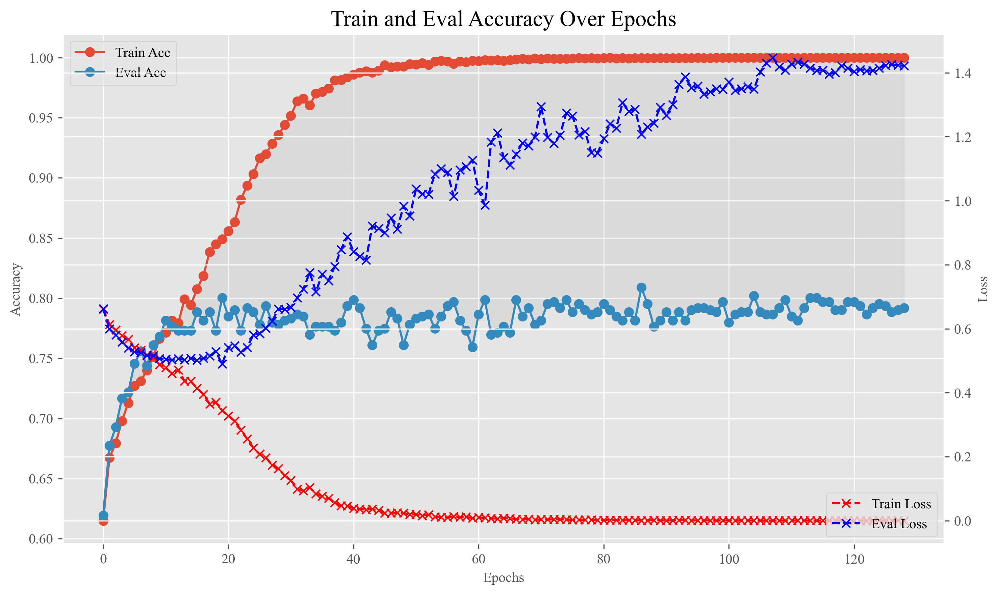

[I 2024-04-29 03:38:55,110] Trial 12 finished with value: 0.8088737201365188 and parameters: {'num_blocks': 5, 'dropout': 0.11659184548055475, 'purns': 0.22691678635353887, 'lr': 9.686674607294513e-05, 'epochs': 129}. Best is trial 11 with value: 0.8208191126279863.


  0%|          | 0/165 [00:00<?, ?it/s]

train_acc0.604129178899517  eval_acc0.6194539249146758
train_acc0.6471256747798086  eval_acc0.658703071672355
train_acc0.6325409603182119  eval_acc0.6382252559726962
train_acc0.666350980206459  eval_acc0.6825938566552902
train_acc0.6564068567099157  eval_acc0.6655290102389079
train_acc0.6754427502604413  eval_acc0.6911262798634812
train_acc0.7000662941566437  eval_acc0.7081911262798635
train_acc0.6851027559427976  eval_acc0.7064846416382252
train_acc0.6925845250497206  eval_acc0.7030716723549488
train_acc0.7170186570697983  eval_acc0.7303754266211604
train_acc0.7253527796192821  eval_acc0.7337883959044369
train_acc0.7060327682545695  eval_acc0.7320819112627986
train_acc0.7239321905483473  eval_acc0.742320819112628
train_acc0.735202197177763  eval_acc0.742320819112628
train_acc0.7442939672317455  eval_acc0.7406143344709898
train_acc0.7442939672317455  eval_acc0.7525597269624573
train_acc0.7476086750639265  eval_acc0.7474402730375427
train_acc0.7548063263566626  eval_acc0.755972696245733

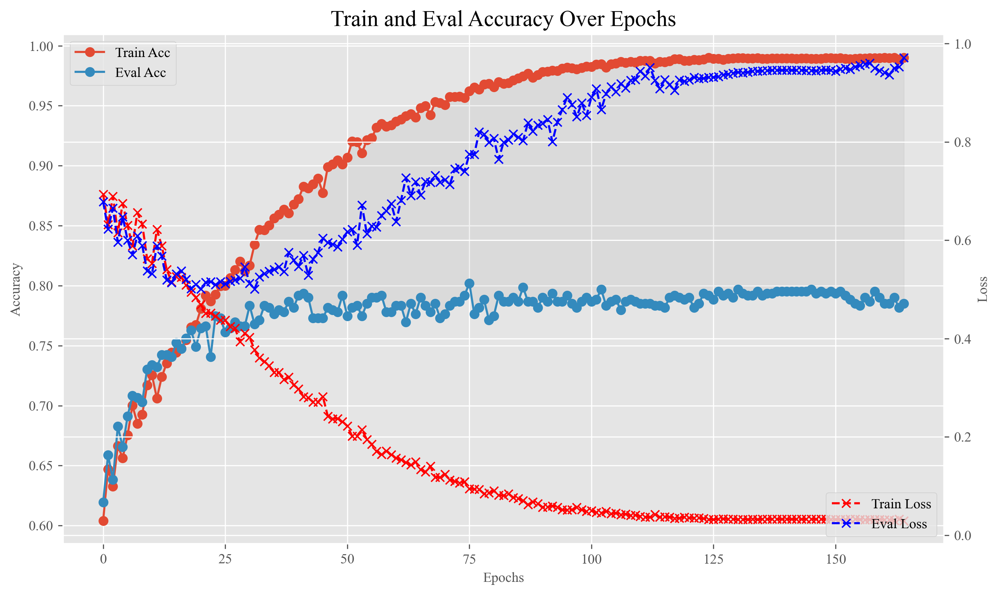

[I 2024-04-29 04:23:51,339] Trial 13 finished with value: 0.8020477815699659 and parameters: {'num_blocks': 5, 'dropout': 0.2994626010534849, 'purns': 0.24411163457558432, 'lr': 9.484556583776159e-05, 'epochs': 165}. Best is trial 11 with value: 0.8208191126279863.


  0%|          | 0/131 [00:00<?, ?it/s]

train_acc0.5807368121981248  eval_acc0.5938566552901023
train_acc0.6277109574770338  eval_acc0.636518771331058
train_acc0.6657827445780851  eval_acc0.6945392491467577
train_acc0.6873756984562932  eval_acc0.7098976109215017
train_acc0.7010133535372668  eval_acc0.7150170648464164
train_acc0.7098210057770622  eval_acc0.7252559726962458
train_acc0.7142721848659911  eval_acc0.726962457337884
train_acc0.7226063074154749  eval_acc0.726962457337884
train_acc0.7344445496732646  eval_acc0.7440273037542662
train_acc0.7360545506203239  eval_acc0.7474402730375427
train_acc0.7527227957192916  eval_acc0.757679180887372
train_acc0.7647504498532058  eval_acc0.7696245733788396
train_acc0.7791457524386779  eval_acc0.7696245733788396
train_acc0.780376929633488  eval_acc0.7610921501706485
train_acc0.7768728099251823  eval_acc0.7662116040955631
train_acc0.786059285917227  eval_acc0.7696245733788396
train_acc0.8091675348044323  eval_acc0.7866894197952219
train_acc0.8138081257694858  eval_acc0.781569965870307

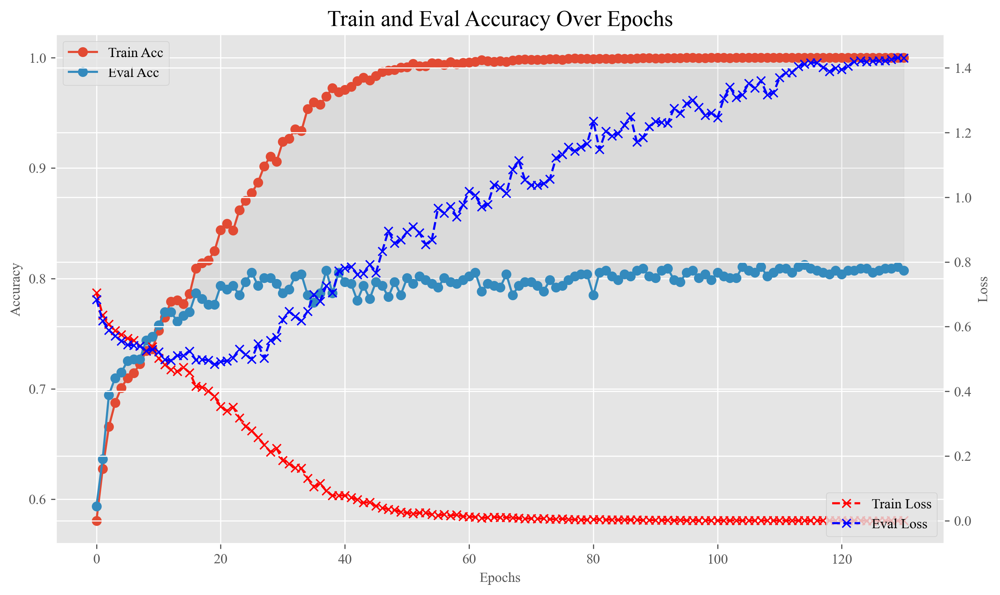

[I 2024-04-29 05:09:56,405] Trial 14 finished with value: 0.8122866894197952 and parameters: {'num_blocks': 6, 'dropout': 0.11143592577095124, 'purns': 0.2075918970325226, 'lr': 6.211241426126053e-05, 'epochs': 131}. Best is trial 11 with value: 0.8208191126279863.


  0%|          | 0/123 [00:00<?, ?it/s]

train_acc0.6082015342361966  eval_acc0.60580204778157
train_acc0.6525239132493608  eval_acc0.6825938566552902
train_acc0.6699498058528269  eval_acc0.6877133105802048
train_acc0.6880386400227294  eval_acc0.7150170648464164
train_acc0.6992139407140828  eval_acc0.7167235494880546
train_acc0.7068851216971304  eval_acc0.7133105802047781
train_acc0.7215645420967894  eval_acc0.735494880546075
train_acc0.731887489345582  eval_acc0.7474402730375427
train_acc0.699592764466332  eval_acc0.7133105802047781
train_acc0.735770432806137  eval_acc0.742320819112628
train_acc0.7594469173217161  eval_acc0.7559726962457338
train_acc0.7679704517473246  eval_acc0.757679180887372
train_acc0.7699592764466332  eval_acc0.7627986348122867
train_acc0.767212804242826  eval_acc0.7679180887372014
train_acc0.7707169239511318  eval_acc0.7508532423208191
train_acc0.7853016384127285  eval_acc0.764505119453925
train_acc0.7978975281750166  eval_acc0.7679180887372014
train_acc0.8018751775736339  eval_acc0.7679180887372014
tr

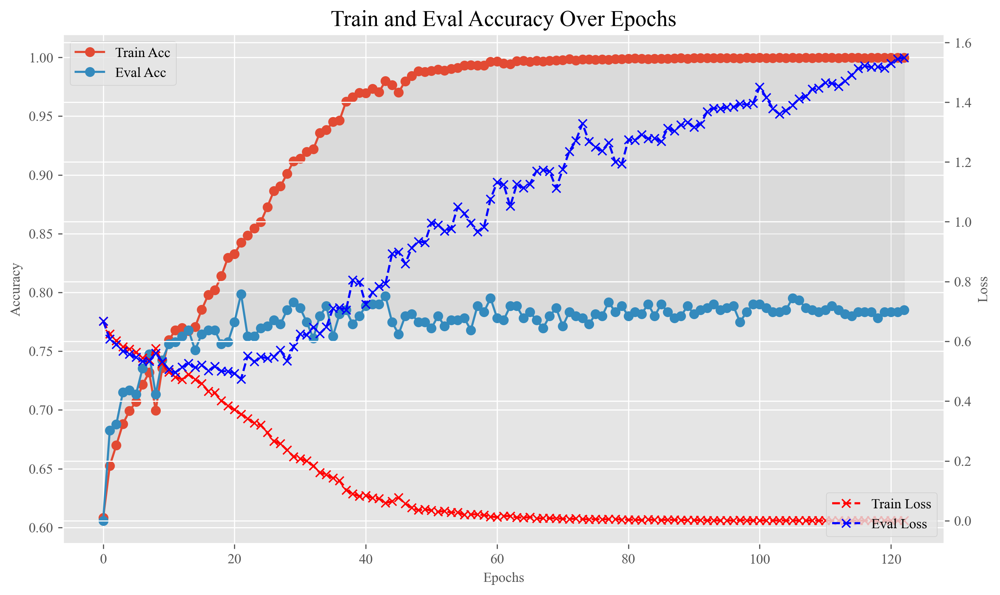

[I 2024-04-29 06:04:39,982] Trial 15 finished with value: 0.7986348122866894 and parameters: {'num_blocks': 6, 'dropout': 0.10153727811754011, 'purns': 0.19497745333420577, 'lr': 4.758523446633553e-05, 'epochs': 123}. Best is trial 11 with value: 0.8208191126279863.


  0%|          | 0/136 [00:00<?, ?it/s]

train_acc0.6120844776967516  eval_acc0.6348122866894198
train_acc0.667866275215456  eval_acc0.689419795221843
train_acc0.690595700350412  eval_acc0.7081911262798635
train_acc0.705559238564258  eval_acc0.7286689419795221
train_acc0.6968462922625248  eval_acc0.7030716723549488
train_acc0.7271521924424661  eval_acc0.7406143344709898
train_acc0.7250686618050952  eval_acc0.742320819112628
train_acc0.752817501657354  eval_acc0.7610921501706485
train_acc0.7459039681788048  eval_acc0.7440273037542662
train_acc0.7609622123307132  eval_acc0.7610921501706485
train_acc0.774694573349749  eval_acc0.7696245733788396
train_acc0.782460460270859  eval_acc0.764505119453925
train_acc0.7965716450421442  eval_acc0.7747440273037542
train_acc0.7983710578653281  eval_acc0.7798634812286689
train_acc0.8168387157874799  eval_acc0.7832764505119454
train_acc0.8236575433279667  eval_acc0.7798634812286689
train_acc0.8247940145847145  eval_acc0.7901023890784983
train_acc0.8336963727625722  eval_acc0.8037542662116041
t

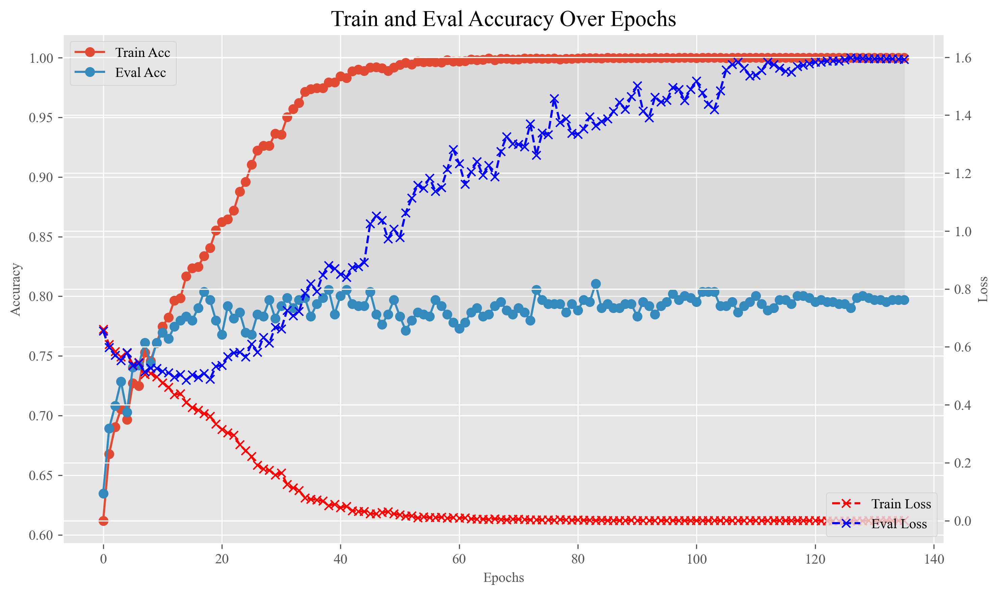

[I 2024-04-29 07:09:56,081] Trial 16 finished with value: 0.810580204778157 and parameters: {'num_blocks': 6, 'dropout': 0.10132753467440658, 'purns': 0.1710265585227585, 'lr': 8.017730096567412e-05, 'epochs': 136}. Best is trial 11 with value: 0.8208191126279863.


  0%|          | 0/100 [00:00<?, ?it/s]

train_acc0.5559238564257979  eval_acc0.5716723549488054
train_acc0.6314044890614642  eval_acc0.6313993174061433
train_acc0.667582157401269  eval_acc0.6757679180887372
train_acc0.6811251065441803  eval_acc0.6962457337883959
train_acc0.6869021687659816  eval_acc0.7030716723549488
train_acc0.6976986457050857  eval_acc0.7081911262798635
train_acc0.7061274741926319  eval_acc0.7320819112627986
train_acc0.7082110048300029  eval_acc0.7286689419795221
train_acc0.7287621933895255  eval_acc0.7406143344709898
train_acc0.7344445496732646  eval_acc0.7337883959044369
train_acc0.7353916090538877  eval_acc0.7389078498293515
train_acc0.7416422009660005  eval_acc0.7457337883959044
train_acc0.7512075007102945  eval_acc0.742320819112628
train_acc0.7557533857372857  eval_acc0.7542662116040956
train_acc0.7640875082867696  eval_acc0.7627986348122867
train_acc0.7546169144805379  eval_acc0.7542662116040956
train_acc0.7760204564826214  eval_acc0.7696245733788396
train_acc0.7798086940051141  eval_acc0.76621160409

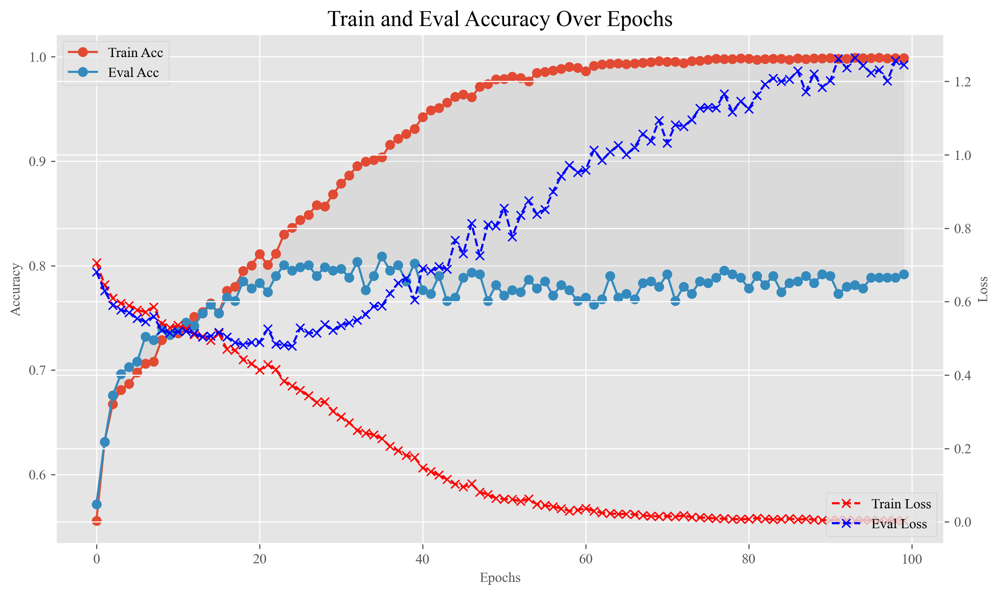

[I 2024-04-29 07:27:31,472] Trial 17 finished with value: 0.8088737201365188 and parameters: {'num_blocks': 3, 'dropout': 0.1250872759925727, 'purns': 0.2115339854703261, 'lr': 4.978809338958764e-05, 'epochs': 100}. Best is trial 11 with value: 0.8208191126279863.


  0%|          | 0/137 [00:00<?, ?it/s]

train_acc0.6181456577327399  eval_acc0.6331058020477816
train_acc0.6684345108438299  eval_acc0.6945392491467577
train_acc0.6815986362344919  eval_acc0.7218430034129693
train_acc0.7031915901127  eval_acc0.7252559726962458
train_acc0.7060327682545695  eval_acc0.7150170648464164
train_acc0.7207121886542286  eval_acc0.7389078498293515
train_acc0.7190074817691069  eval_acc0.7508532423208191
train_acc0.7137039492376172  eval_acc0.7201365187713311
train_acc0.7442939672317455  eval_acc0.7491467576791809
train_acc0.7491239700729235  eval_acc0.7542662116040956
train_acc0.7578369163746567  eval_acc0.7593856655290102
train_acc0.7747892792878114  eval_acc0.7627986348122867
train_acc0.7707169239511318  eval_acc0.7593856655290102
train_acc0.7861539918552893  eval_acc0.773037542662116
train_acc0.7830286958992329  eval_acc0.764505119453925
train_acc0.7720428070840042  eval_acc0.757679180887372
train_acc0.7897528175016574  eval_acc0.7542662116040956
train_acc0.8050951794677527  eval_acc0.784982935153583

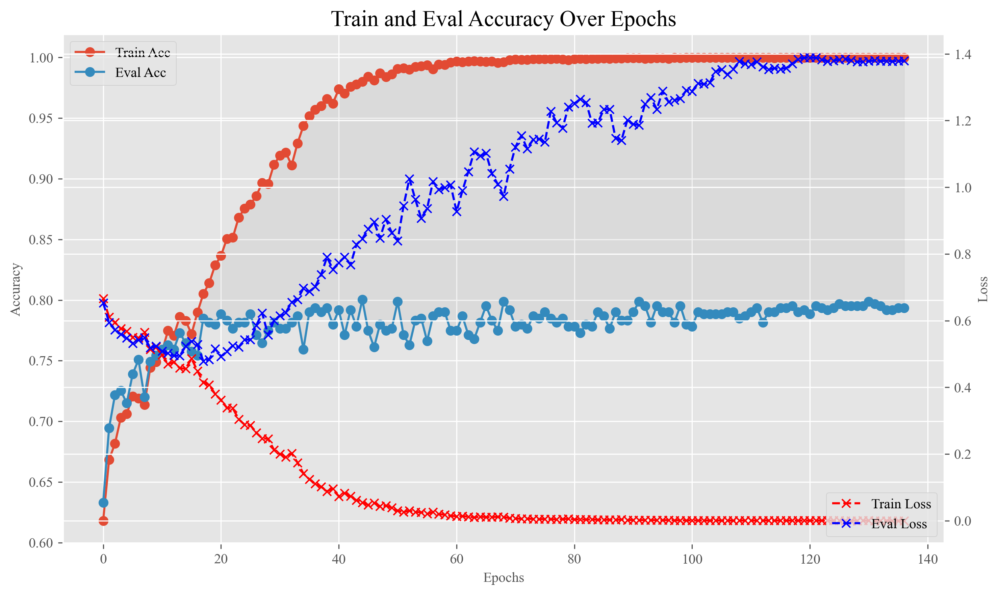

[I 2024-04-29 08:29:37,118] Trial 18 finished with value: 0.8003412969283277 and parameters: {'num_blocks': 6, 'dropout': 0.13395074333656606, 'purns': 0.10147342091823401, 'lr': 7.779332632310088e-05, 'epochs': 137}. Best is trial 11 with value: 0.8208191126279863.


  0%|          | 0/118 [00:00<?, ?it/s]

train_acc0.5907756416327303  eval_acc0.5921501706484642
train_acc0.6434321431953783  eval_acc0.6706484641638225
train_acc0.6683398049057676  eval_acc0.7013651877133106
train_acc0.6787574580926224  eval_acc0.6962457337883959
train_acc0.6801780471635571  eval_acc0.7030716723549488
train_acc0.7029074722985131  eval_acc0.7235494880546075
train_acc0.7060327682545695  eval_acc0.7167235494880546
train_acc0.7117151245383085  eval_acc0.735494880546075
train_acc0.724405720238659  eval_acc0.7389078498293515
train_acc0.7260157211857183  eval_acc0.7372013651877133
train_acc0.7311298418410834  eval_acc0.7457337883959044
train_acc0.7315086655933327  eval_acc0.7440273037542662
train_acc0.7442939672317455  eval_acc0.7440273037542662
train_acc0.7529122075954162  eval_acc0.7508532423208191
train_acc0.7503551472677337  eval_acc0.7508532423208191
train_acc0.7627616251538971  eval_acc0.7713310580204779
train_acc0.7722322189601288  eval_acc0.7696245733788396
train_acc0.7647504498532058  eval_acc0.75597269624

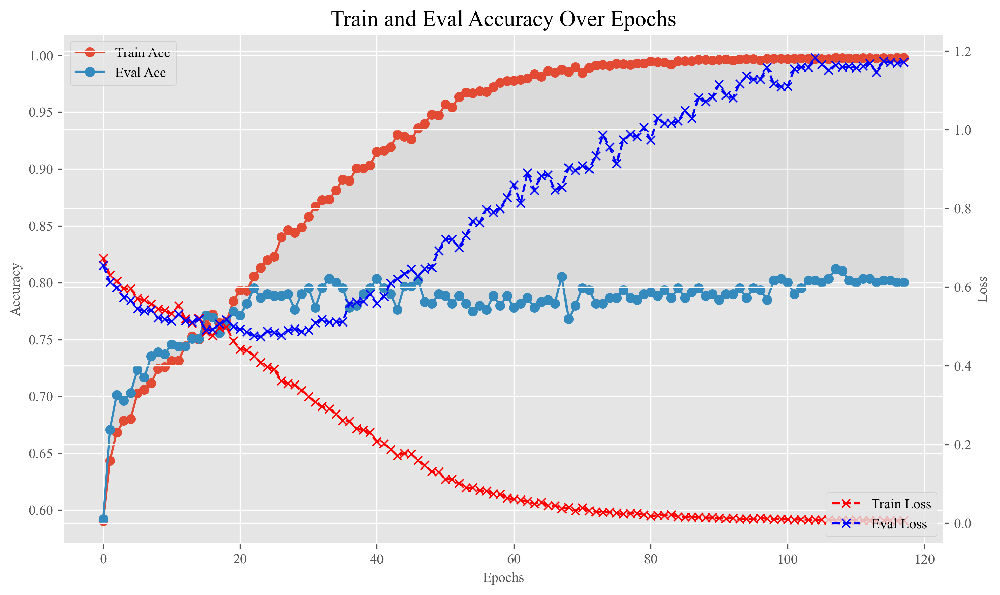

[I 2024-04-29 09:07:09,852] Trial 19 finished with value: 0.8122866894197952 and parameters: {'num_blocks': 5, 'dropout': 0.17635427277037335, 'purns': 0.26302221440479084, 'lr': 4.6038859208878804e-05, 'epochs': 118}. Best is trial 11 with value: 0.8208191126279863.


  0%|          | 0/140 [00:00<?, ?it/s]

train_acc0.6218391893171702  eval_acc0.636518771331058
train_acc0.6707074533573255  eval_acc0.7030716723549488
train_acc0.6815986362344919  eval_acc0.7030716723549488
train_acc0.697793351643148  eval_acc0.7133105802047781
train_acc0.6868074628279193  eval_acc0.7013651877133106
train_acc0.7193863055213562  eval_acc0.735494880546075
train_acc0.7233639549199735  eval_acc0.7389078498293515
train_acc0.7218486599109765  eval_acc0.7218430034129693
train_acc0.746566909745241  eval_acc0.7303754266211604
train_acc0.7593522113836537  eval_acc0.7610921501706485
train_acc0.7584051520030306  eval_acc0.7372013651877133
train_acc0.7610569182687754  eval_acc0.7508532423208191
train_acc0.7631404489061464  eval_acc0.742320819112628
train_acc0.7845439909082299  eval_acc0.7713310580204779
train_acc0.7893739937494081  eval_acc0.78839590443686
train_acc0.8083151813618714  eval_acc0.7747440273037542
train_acc0.8161757742210437  eval_acc0.7662116040955631
train_acc0.8253622502130884  eval_acc0.7849829351535836

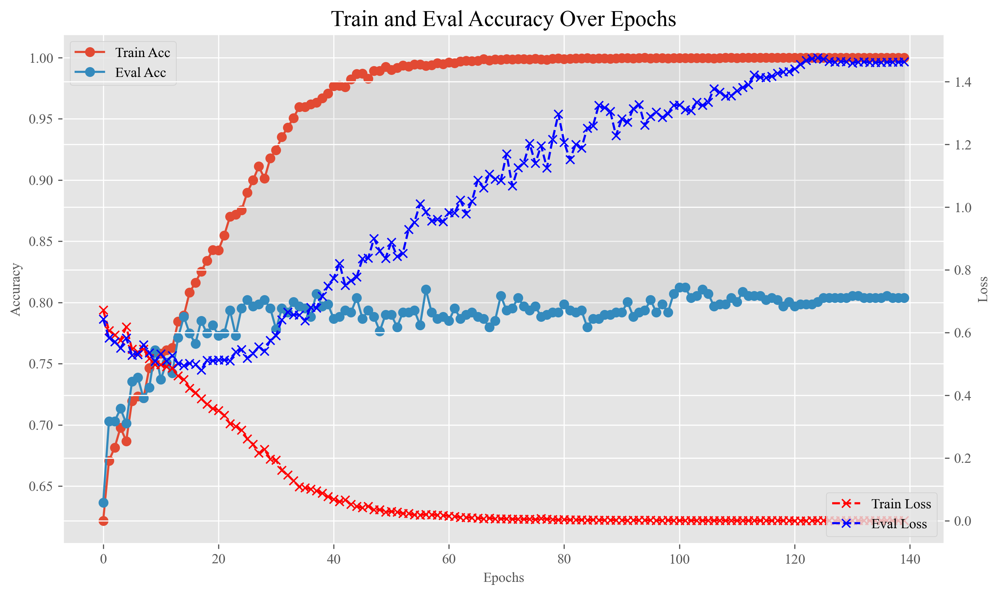

[I 2024-04-29 10:33:23,835] Trial 20 finished with value: 0.8122866894197952 and parameters: {'num_blocks': 6, 'dropout': 0.1420205377128384, 'purns': 0.21711642561689312, 'lr': 9.747044537559583e-05, 'epochs': 140}. Best is trial 11 with value: 0.8208191126279863.


  0%|          | 0/116 [00:00<?, ?it/s]

train_acc0.6057391798465763  eval_acc0.6262798634812287
train_acc0.6529027370016101  eval_acc0.6877133105802048
train_acc0.6669192158348328  eval_acc0.7081911262798635
train_acc0.6891751112794772  eval_acc0.7081911262798635
train_acc0.6975092338289611  eval_acc0.7047781569965871
train_acc0.7088739463964391  eval_acc0.7184300341296929
train_acc0.7176815986362345  eval_acc0.7218430034129693
train_acc0.7271521924424661  eval_acc0.7320819112627986
train_acc0.7350127853016384  eval_acc0.7457337883959044
train_acc0.7395586703286297  eval_acc0.7525597269624573
train_acc0.7471351453736149  eval_acc0.7457337883959044
train_acc0.7508286769580452  eval_acc0.7525597269624573
train_acc0.7493133819490482  eval_acc0.7474402730375427
train_acc0.7573633866843451  eval_acc0.7457337883959044
train_acc0.7666445686144521  eval_acc0.7662116040955631
train_acc0.7772516336774316  eval_acc0.7798634812286689
train_acc0.7907945828203429  eval_acc0.7662116040955631
train_acc0.7905104650061558  eval_acc0.776450511

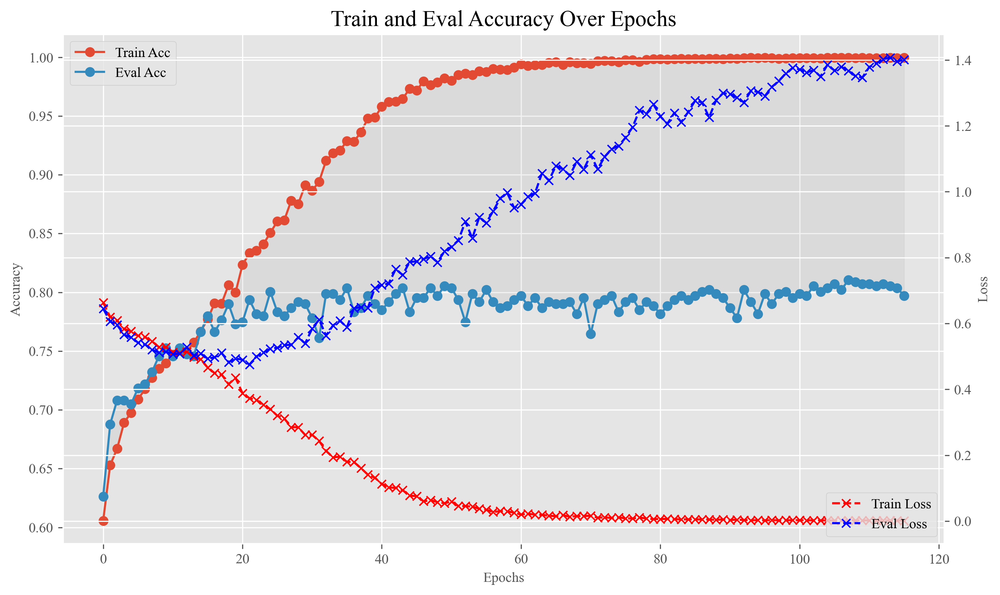

[I 2024-04-29 11:18:24,624] Trial 21 finished with value: 0.810580204778157 and parameters: {'num_blocks': 5, 'dropout': 0.11521271010782552, 'purns': 0.2692401072967968, 'lr': 4.435967084980344e-05, 'epochs': 116}. Best is trial 11 with value: 0.8208191126279863.


  0%|          | 0/117 [00:00<?, ?it/s]

train_acc0.6027085898285822  eval_acc0.5802047781569966
train_acc0.6550809735770433  eval_acc0.6638225255972696
train_acc0.6726015721185719  eval_acc0.7081911262798635
train_acc0.6837768728099252  eval_acc0.6843003412969283
train_acc0.6975092338289611  eval_acc0.6996587030716723
train_acc0.6886068756511033  eval_acc0.7150170648464164
train_acc0.6990245288379582  eval_acc0.7201365187713311
train_acc0.7080215929538782  eval_acc0.7201365187713311
train_acc0.7253527796192821  eval_acc0.7303754266211604
train_acc0.7349180793635761  eval_acc0.7372013651877133
train_acc0.7320769012217067  eval_acc0.7320819112627986
train_acc0.7541433847902264  eval_acc0.7559726962457338
train_acc0.7556586797992234  eval_acc0.7713310580204779
train_acc0.7622880954635856  eval_acc0.7610921501706485
train_acc0.7760204564826214  eval_acc0.7593856655290102
train_acc0.7829339899611706  eval_acc0.7593856655290102
train_acc0.7888057581210342  eval_acc0.7662116040955631
train_acc0.7927834075196515  eval_acc0.771331058

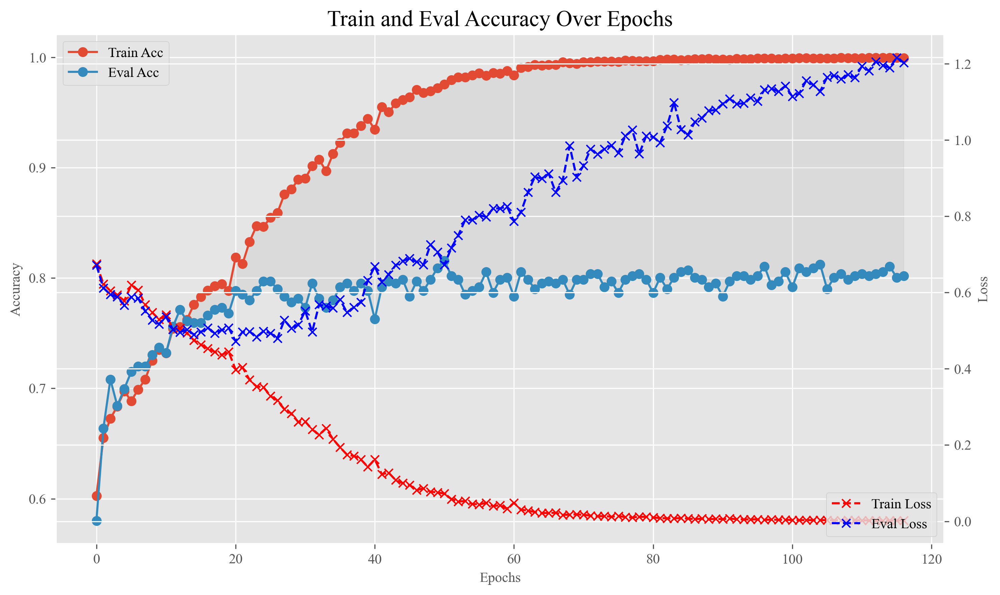

[I 2024-04-29 12:11:42,984] Trial 22 finished with value: 0.8156996587030717 and parameters: {'num_blocks': 5, 'dropout': 0.17708475522814848, 'purns': 0.23013001263461688, 'lr': 7.221760708149414e-05, 'epochs': 117}. Best is trial 11 with value: 0.8208191126279863.


  0%|          | 0/131 [00:00<?, ?it/s]

train_acc0.62060801212236  eval_acc0.6160409556313993
train_acc0.6566909745241026  eval_acc0.689419795221843
train_acc0.666350980206459  eval_acc0.6945392491467577
train_acc0.6949521735012786  eval_acc0.71160409556314
train_acc0.7064115920068188  eval_acc0.726962457337884
train_acc0.711241594847997  eval_acc0.726962457337884
train_acc0.7172080689459229  eval_acc0.71160409556314
train_acc0.7258263093095937  eval_acc0.7320819112627986
train_acc0.7103892414054361  eval_acc0.7184300341296929
train_acc0.7423998484704991  eval_acc0.7303754266211604
train_acc0.7424945544085614  eval_acc0.7372013651877133
train_acc0.7628563310919595  eval_acc0.742320819112628
train_acc0.7751681030400606  eval_acc0.7747440273037542
train_acc0.7859645799791647  eval_acc0.764505119453925
train_acc0.7955298797234587  eval_acc0.7747440273037542
train_acc0.795340467847334  eval_acc0.7764505119453925
train_acc0.7965716450421442  eval_acc0.7627986348122867
train_acc0.8148498910881712  eval_acc0.764505119453925
train_a

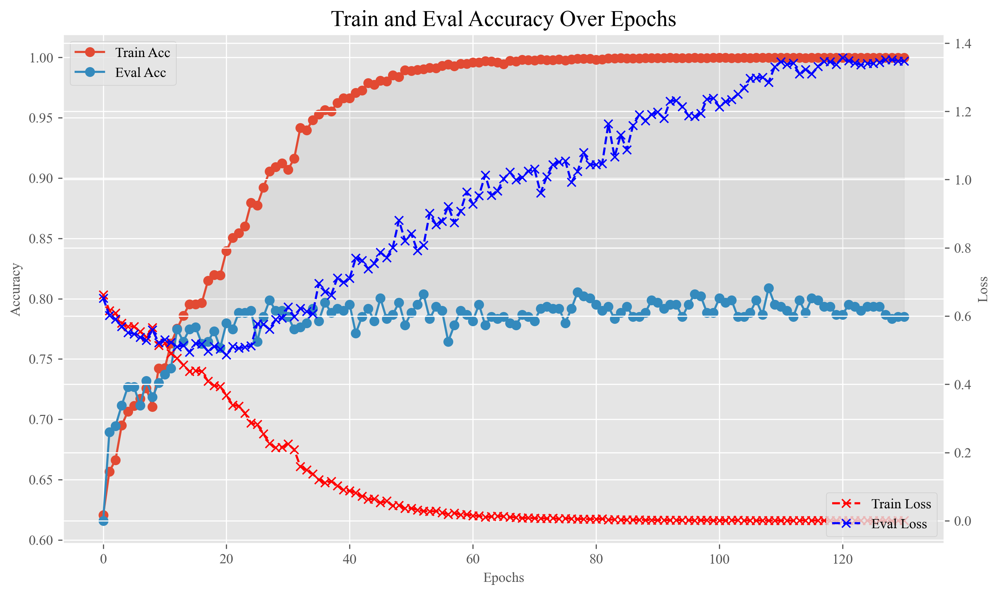

[I 2024-04-29 13:59:17,307] Trial 23 finished with value: 0.8088737201365188 and parameters: {'num_blocks': 6, 'dropout': 0.1419670857794526, 'purns': 0.2278113561368943, 'lr': 7.748347354415918e-05, 'epochs': 131}. Best is trial 11 with value: 0.8208191126279863.


  0%|          | 0/142 [00:00<?, ?it/s]

train_acc0.5958897622880954  eval_acc0.6245733788395904
train_acc0.6553650913912302  eval_acc0.6928327645051194
train_acc0.6742115730656312  eval_acc0.7150170648464164
train_acc0.6847239321905484  eval_acc0.7150170648464164
train_acc0.6883227578369163  eval_acc0.7081911262798635
train_acc0.673548631499195  eval_acc0.689419795221843
train_acc0.7042333554313855  eval_acc0.7184300341296929
train_acc0.7084951226441898  eval_acc0.7406143344709898
train_acc0.7109574770338101  eval_acc0.7201365187713311
train_acc0.7249739558670328  eval_acc0.7372013651877133
train_acc0.7406951415853774  eval_acc0.7542662116040956
train_acc0.7428733781608107  eval_acc0.7508532423208191
train_acc0.7572686807462828  eval_acc0.7610921501706485
train_acc0.7524386779051047  eval_acc0.757679180887372
train_acc0.7673075101808884  eval_acc0.7474402730375427
train_acc0.7756416327303722  eval_acc0.7696245733788396
train_acc0.7817975187044228  eval_acc0.7525597269624573
train_acc0.7838810493417937  eval_acc0.755972696245

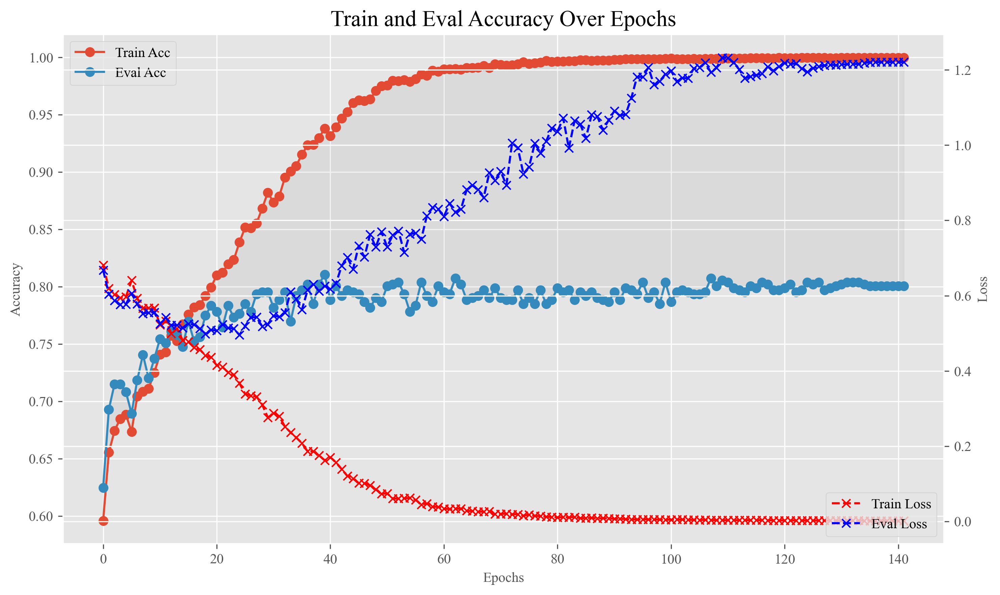

[I 2024-04-29 16:03:50,616] Trial 24 finished with value: 0.810580204778157 and parameters: {'num_blocks': 5, 'dropout': 0.1797143391228944, 'purns': 0.19814614356981441, 'lr': 7.325450729057851e-05, 'epochs': 142}. Best is trial 11 with value: 0.8208191126279863.


  0%|          | 0/158 [00:00<?, ?it/s]

train_acc0.5747703381001988  eval_acc0.6040955631399317
train_acc0.6252486030874136  eval_acc0.6450511945392492
train_acc0.6597215645420967  eval_acc0.6911262798634812
train_acc0.6838715787479875  eval_acc0.7013651877133106
train_acc0.6708968652334502  eval_acc0.6979522184300341
train_acc0.709158064210626  eval_acc0.7184300341296929
train_acc0.7173027748839852  eval_acc0.7303754266211604
train_acc0.731887489345582  eval_acc0.7372013651877133
train_acc0.7340657259210153  eval_acc0.7372013651877133
train_acc0.740600435647315  eval_acc0.7474402730375427
train_acc0.7491239700729235  eval_acc0.7474402730375427
train_acc0.7416422009660005  eval_acc0.7406143344709898
train_acc0.7520598541528554  eval_acc0.7627986348122867
train_acc0.7691069230040724  eval_acc0.7627986348122867
train_acc0.7741263377213752  eval_acc0.7764505119453925
train_acc0.7687280992518231  eval_acc0.7713310580204779
train_acc0.7925939956435268  eval_acc0.7918088737201365
train_acc0.7972345866085804  eval_acc0.769624573378

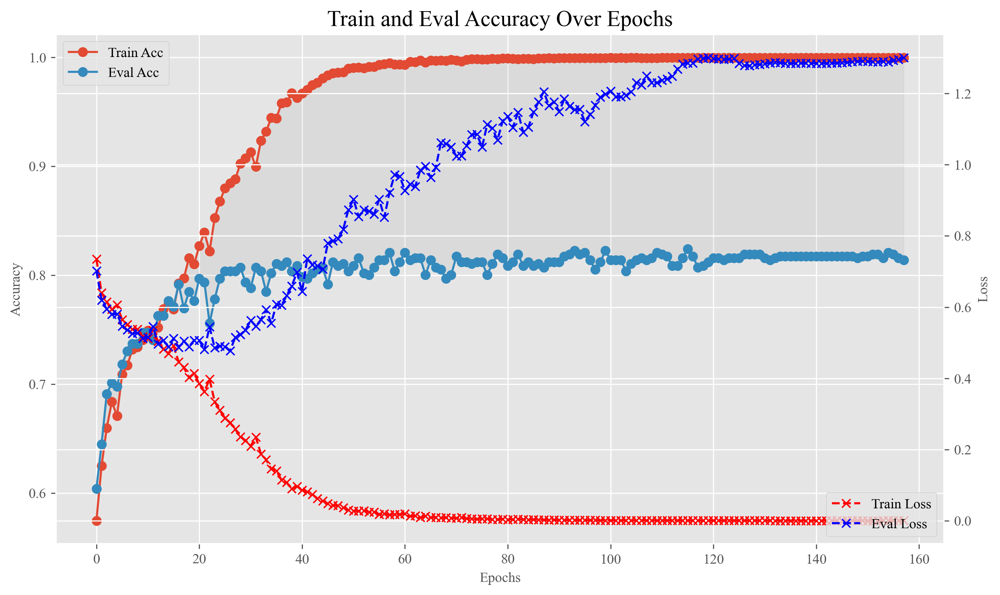

[I 2024-04-29 16:43:16,575] Trial 25 finished with value: 0.8242320819112628 and parameters: {'num_blocks': 4, 'dropout': 0.11151013624303092, 'purns': 0.18669610558469038, 'lr': 5.763967547038369e-05, 'epochs': 158}. Best is trial 25 with value: 0.8242320819112628.


  0%|          | 0/162 [00:00<?, ?it/s]

train_acc0.585282697225116  eval_acc0.5870307167235495
train_acc0.6540392082583578  eval_acc0.674061433447099
train_acc0.6640780376929634  eval_acc0.6808873720136519
train_acc0.6950468794393408  eval_acc0.7047781569965871
train_acc0.6924898191116583  eval_acc0.7201365187713311
train_acc0.7159768917511128  eval_acc0.7184300341296929
train_acc0.7240268964864097  eval_acc0.726962457337884
train_acc0.7226063074154749  eval_acc0.726962457337884
train_acc0.7341604318590775  eval_acc0.7457337883959044
train_acc0.7472298513116773  eval_acc0.7627986348122867
train_acc0.7511127947722323  eval_acc0.7525597269624573
train_acc0.7673075101808884  eval_acc0.7713310580204779
train_acc0.7739369258452505  eval_acc0.7679180887372014
train_acc0.7717586892698172  eval_acc0.764505119453925
train_acc0.7855857562269154  eval_acc0.7696245733788396
train_acc0.7982763519272659  eval_acc0.7832764505119454
train_acc0.8017804716355715  eval_acc0.7696245733788396
train_acc0.8138081257694858  eval_acc0.78156996587030

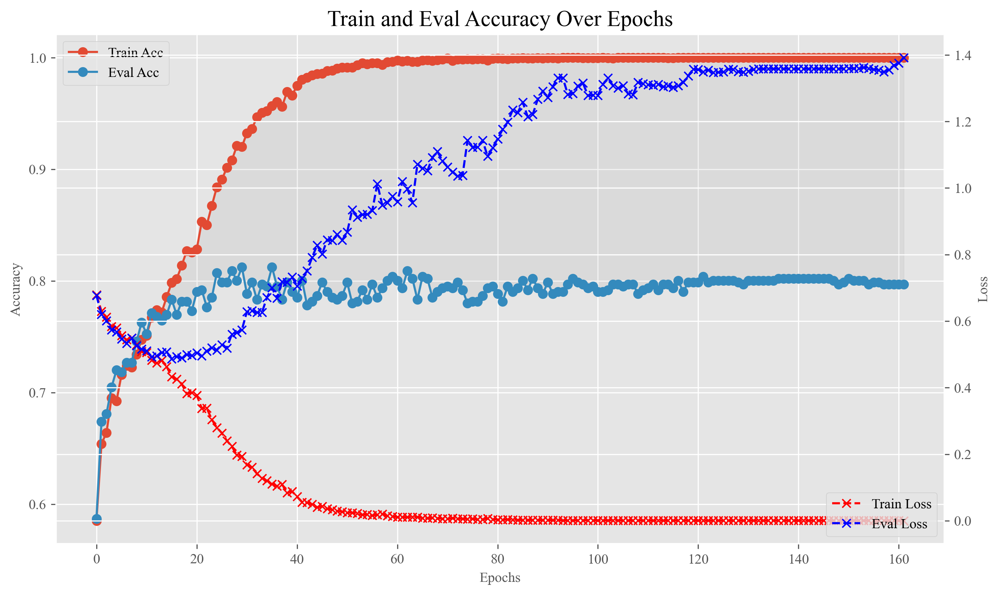

[I 2024-04-29 17:11:52,457] Trial 26 finished with value: 0.8122866894197952 and parameters: {'num_blocks': 3, 'dropout': 0.12393618430608047, 'purns': 0.183074528060522, 'lr': 8.427555869737079e-05, 'epochs': 162}. Best is trial 25 with value: 0.8242320819112628.


  0%|          | 0/177 [00:00<?, ?it/s]

train_acc0.5883132872431102  eval_acc0.6126279863481229
train_acc0.6468415569656217  eval_acc0.674061433447099
train_acc0.6719386305521357  eval_acc0.6979522184300341
train_acc0.6859551093853584  eval_acc0.7167235494880546
train_acc0.6870915806421063  eval_acc0.7030716723549488
train_acc0.7063168860687565  eval_acc0.7150170648464164
train_acc0.7045174732455725  eval_acc0.7047781569965871
train_acc0.7228904252296618  eval_acc0.7252559726962458
train_acc0.7228904252296618  eval_acc0.7474402730375427
train_acc0.7337816081068284  eval_acc0.7320819112627986
train_acc0.7410739653376267  eval_acc0.7593856655290102
train_acc0.7495027938251728  eval_acc0.7525597269624573
train_acc0.7550904441708495  eval_acc0.764505119453925
train_acc0.7606780945165262  eval_acc0.7662116040955631
train_acc0.7631404489061464  eval_acc0.7627986348122867
train_acc0.7690122170660101  eval_acc0.7610921501706485
train_acc0.7811345771379865  eval_acc0.773037542662116
train_acc0.7753575149161852  eval_acc0.769624573378

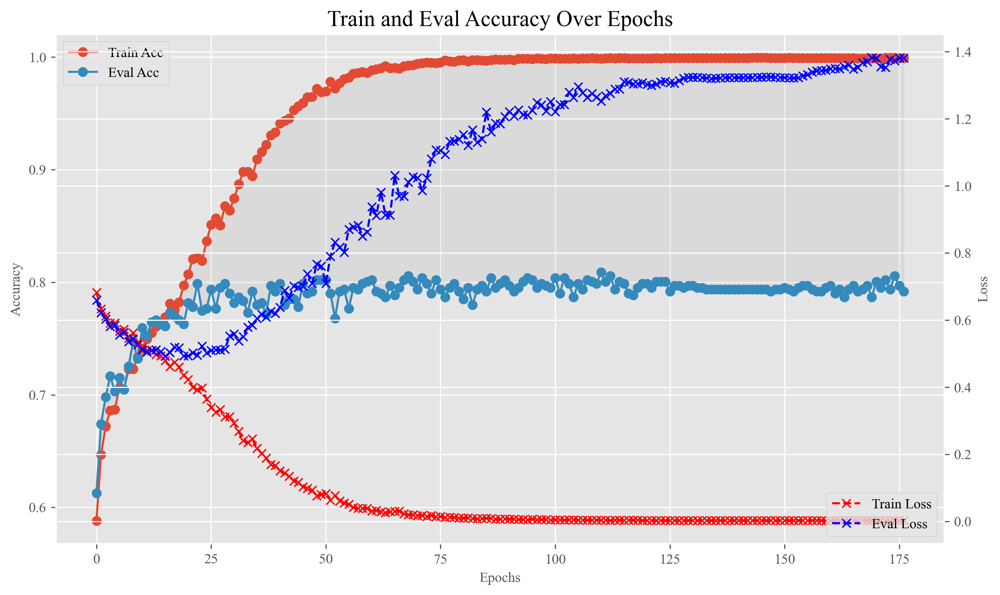

[I 2024-04-29 17:59:17,397] Trial 27 finished with value: 0.8088737201365188 and parameters: {'num_blocks': 4, 'dropout': 0.1518360039296051, 'purns': 0.16238274644128753, 'lr': 5.567843543302649e-05, 'epochs': 177}. Best is trial 25 with value: 0.8242320819112628.


  0%|          | 0/156 [00:00<?, ?it/s]

train_acc0.6124633014490009  eval_acc0.6126279863481229
train_acc0.6593427407898476  eval_acc0.6808873720136519
train_acc0.6664456861445213  eval_acc0.6808873720136519
train_acc0.6837768728099252  eval_acc0.7098976109215017
train_acc0.7040439435552609  eval_acc0.7081911262798635
train_acc0.7108627710957477  eval_acc0.7201365187713311
train_acc0.7203333649019793  eval_acc0.742320819112628
train_acc0.7308457240268965  eval_acc0.7372013651877133
train_acc0.7308457240268965  eval_acc0.7474402730375427
train_acc0.7408845534615021  eval_acc0.7303754266211604
train_acc0.742968084098873  eval_acc0.7337883959044369
train_acc0.7646557439151435  eval_acc0.7679180887372014
train_acc0.7711904536414433  eval_acc0.7662116040955631
train_acc0.7773463396154939  eval_acc0.7713310580204779
train_acc0.78577516810304  eval_acc0.7542662116040956
train_acc0.7969504687943935  eval_acc0.7866894197952219
train_acc0.8088834169902452  eval_acc0.7901023890784983
train_acc0.8142816554597974  eval_acc0.7815699658703

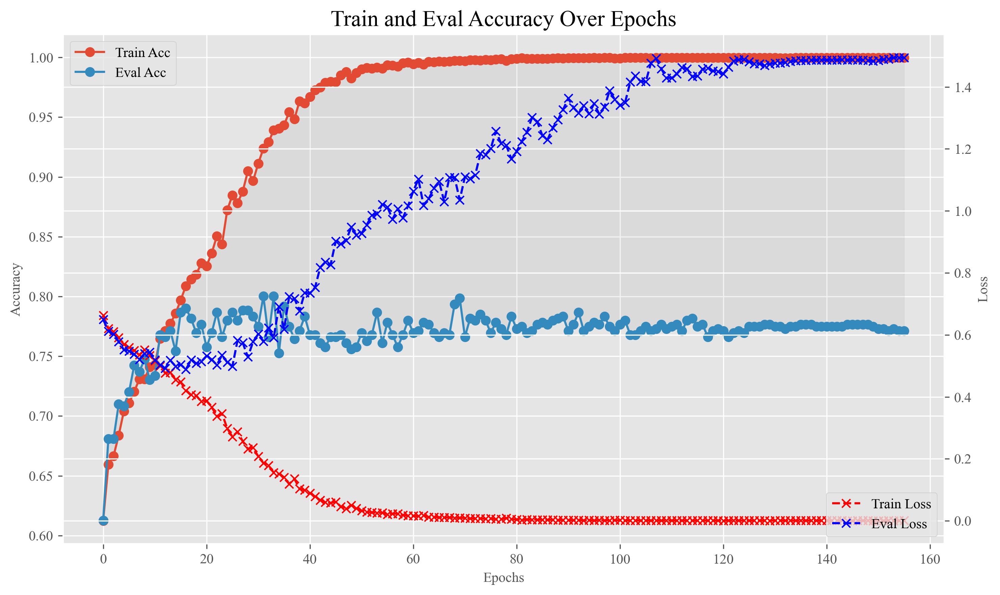

[I 2024-04-29 18:58:25,697] Trial 28 finished with value: 0.8003412969283277 and parameters: {'num_blocks': 4, 'dropout': 0.13071375759146464, 'purns': 0.19390955000507162, 'lr': 6.950628656964359e-05, 'epochs': 156}. Best is trial 25 with value: 0.8242320819112628.


  0%|          | 0/180 [00:00<?, ?it/s]

train_acc0.5598067998863528  eval_acc0.5767918088737202
train_acc0.6335827256368974  eval_acc0.6416382252559727
train_acc0.6673927455251444  eval_acc0.7047781569965871
train_acc0.6795151055971209  eval_acc0.6979522184300341
train_acc0.690027464722038  eval_acc0.6962457337883959
train_acc0.6982668813334596  eval_acc0.7064846416382252
train_acc0.7092527701486884  eval_acc0.7286689419795221
train_acc0.7173974808220476  eval_acc0.7303754266211604
train_acc0.7280045458850269  eval_acc0.7474402730375427
train_acc0.7239321905483473  eval_acc0.7201365187713311
train_acc0.7316980774694574  eval_acc0.742320819112628
train_acc0.7310351359030212  eval_acc0.742320819112628
train_acc0.7525333838431669  eval_acc0.7610921501706485
train_acc0.748650440382612  eval_acc0.7474402730375427
train_acc0.7685386873756984  eval_acc0.7627986348122867
train_acc0.7459986741168672  eval_acc0.7525597269624573
train_acc0.7751681030400606  eval_acc0.7696245733788396
train_acc0.7919310540770906  eval_acc0.7662116040955

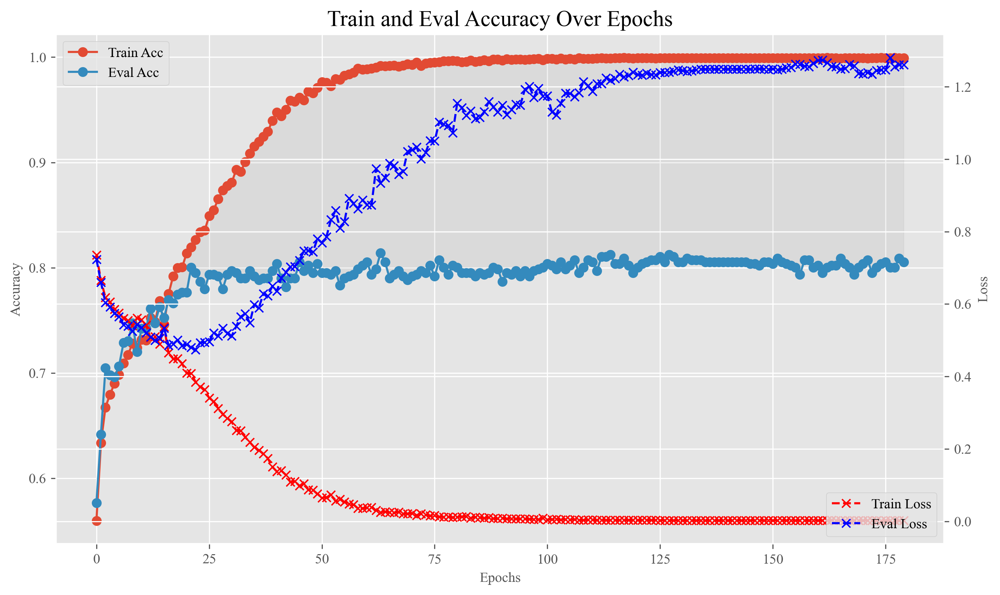

[I 2024-04-29 19:22:58,248] Trial 29 finished with value: 0.8139931740614335 and parameters: {'num_blocks': 2, 'dropout': 0.17030131603736223, 'purns': 0.1788913600176715, 'lr': 8.697323627491621e-05, 'epochs': 180}. Best is trial 25 with value: 0.8242320819112628.


  0%|          | 0/158 [00:00<?, ?it/s]

train_acc0.6049815323420779  eval_acc0.5955631399317406
train_acc0.6548915617009187  eval_acc0.6552901023890785
train_acc0.671465100861824  eval_acc0.689419795221843
train_acc0.684629226252486  eval_acc0.6843003412969283
train_acc0.6919215834832844  eval_acc0.6911262798634812
train_acc0.7024339426082016  eval_acc0.7047781569965871
train_acc0.7095368879628753  eval_acc0.7064846416382252
train_acc0.718155128326546  eval_acc0.7218430034129693
train_acc0.7131357136092433  eval_acc0.7167235494880546
train_acc0.7260157211857183  eval_acc0.7303754266211604
train_acc0.7300880765223979  eval_acc0.7286689419795221
train_acc0.7409792593995643  eval_acc0.7235494880546075
train_acc0.7404110237711905  eval_acc0.7559726962457338
train_acc0.7356757268680746  eval_acc0.7303754266211604
train_acc0.7546169144805379  eval_acc0.7525597269624573
train_acc0.7710010417653187  eval_acc0.7559726962457338
train_acc0.7805663415096127  eval_acc0.7593856655290102
train_acc0.7793351643148025  eval_acc0.7696245733788

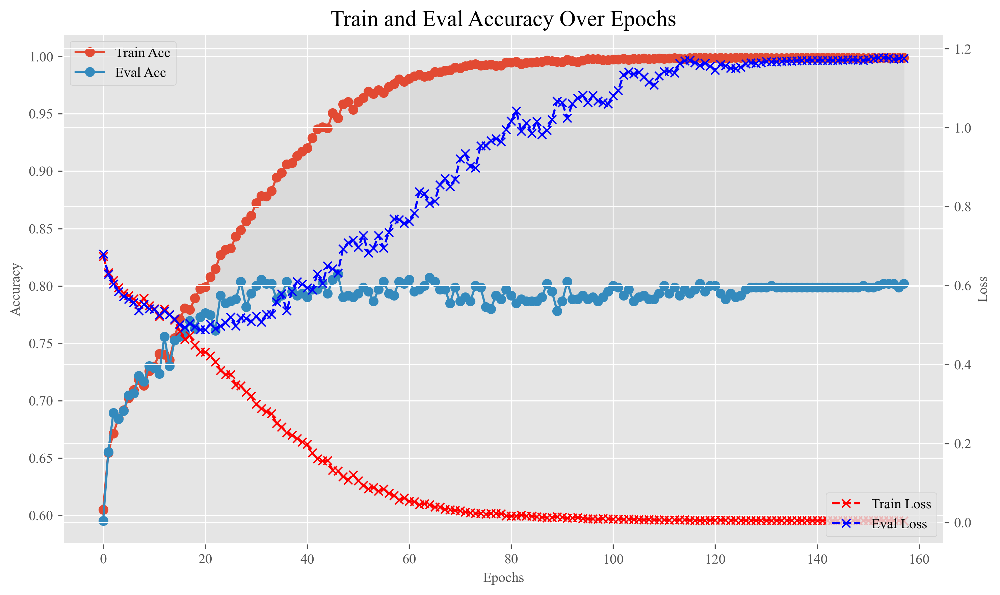

[I 2024-04-29 19:51:16,236] Trial 30 finished with value: 0.810580204778157 and parameters: {'num_blocks': 3, 'dropout': 0.1897758876203145, 'purns': 0.22595912270117352, 'lr': 6.998959757737151e-05, 'epochs': 158}. Best is trial 25 with value: 0.8242320819112628.


  0%|          | 0/182 [00:00<?, ?it/s]

train_acc0.543990908229946  eval_acc0.5443686006825939
train_acc0.6320674306279004  eval_acc0.6501706484641638
train_acc0.639738611610948  eval_acc0.6638225255972696
train_acc0.6749692205701298  eval_acc0.6945392491467577
train_acc0.6858604034472962  eval_acc0.7013651877133106
train_acc0.7041386494933233  eval_acc0.7201365187713311
train_acc0.709158064210626  eval_acc0.7303754266211604
train_acc0.7232692489819111  eval_acc0.7337883959044369
train_acc0.7319821952836443  eval_acc0.7372013651877133
train_acc0.7293304290178995  eval_acc0.7474402730375427
train_acc0.7427786722227484  eval_acc0.7440273037542662
train_acc0.7436310256653093  eval_acc0.7559726962457338
train_acc0.754332796666351  eval_acc0.7525597269624573
train_acc0.7510180888341699  eval_acc0.757679180887372
train_acc0.7656028032957667  eval_acc0.7713310580204779
train_acc0.7674969220570129  eval_acc0.7713310580204779
train_acc0.7711904536414433  eval_acc0.7696245733788396
train_acc0.7815134008902358  eval_acc0.77474402730375

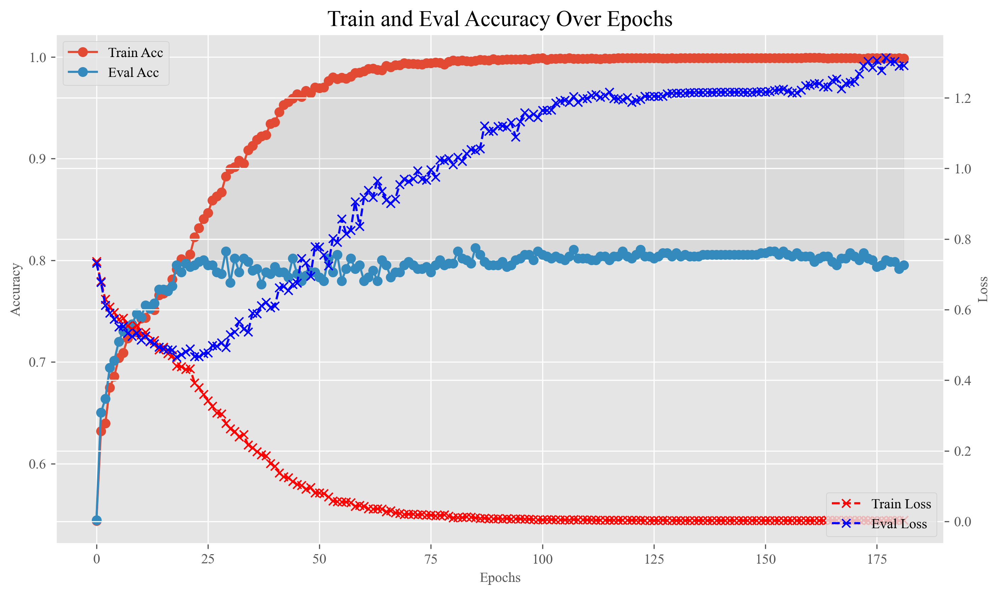

[I 2024-04-29 20:15:53,444] Trial 31 finished with value: 0.8122866894197952 and parameters: {'num_blocks': 2, 'dropout': 0.16434218711275247, 'purns': 0.17783069086762401, 'lr': 8.747216488614209e-05, 'epochs': 182}. Best is trial 25 with value: 0.8242320819112628.


  0%|          | 0/174 [00:00<?, ?it/s]

train_acc0.5926697603939767  eval_acc0.6075085324232082
train_acc0.6451368500805  eval_acc0.6638225255972696
train_acc0.6698550999147647  eval_acc0.6911262798634812
train_acc0.686712756889857  eval_acc0.7030716723549488
train_acc0.6940051141206554  eval_acc0.7013651877133106
train_acc0.7048962969978217  eval_acc0.7235494880546075
train_acc0.7155980679988635  eval_acc0.7235494880546075
train_acc0.7227957192915996  eval_acc0.7252559726962458
train_acc0.725636897433469  eval_acc0.7286689419795221
train_acc0.7286674874514633  eval_acc0.735494880546075
train_acc0.7340657259210153  eval_acc0.7406143344709898
train_acc0.7339710199829529  eval_acc0.7389078498293515
train_acc0.7477980869400511  eval_acc0.7474402730375427
train_acc0.7503551472677337  eval_acc0.757679180887372
train_acc0.7616251538971494  eval_acc0.7662116040955631
train_acc0.7700539823846955  eval_acc0.7593856655290102
train_acc0.7784828108722417  eval_acc0.7662116040955631
train_acc0.7829339899611706  eval_acc0.7593856655290102

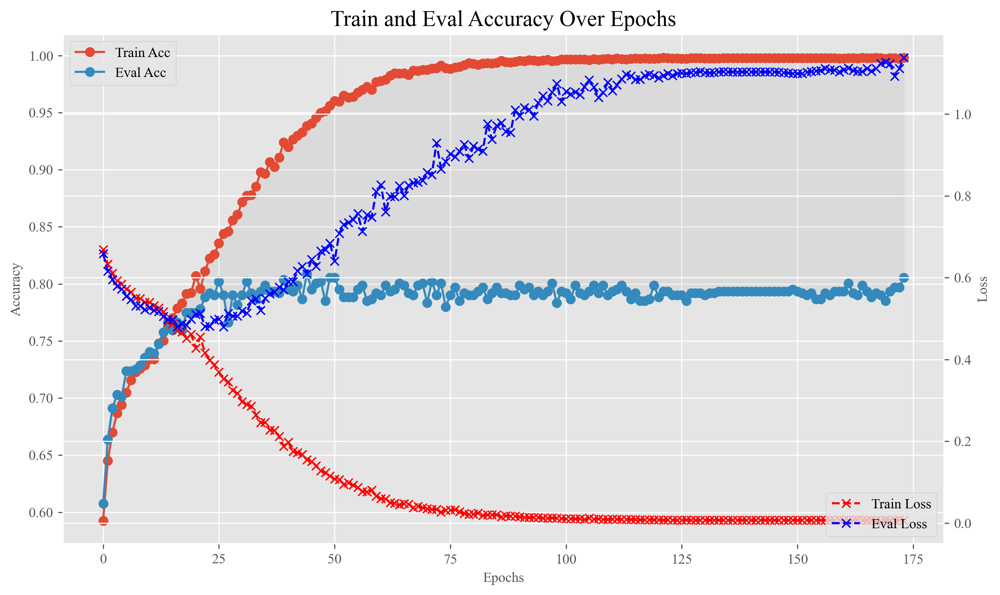

[I 2024-04-29 20:39:31,051] Trial 32 finished with value: 0.8088737201365188 and parameters: {'num_blocks': 2, 'dropout': 0.20598534003833335, 'purns': 0.18017217183878875, 'lr': 8.613468679025555e-05, 'epochs': 174}. Best is trial 25 with value: 0.8242320819112628.


  0%|          | 0/180 [00:00<?, ?it/s]

train_acc0.6186191874230514  eval_acc0.6126279863481229
train_acc0.6520503835590492  eval_acc0.6774744027303754
train_acc0.6654986267638981  eval_acc0.6911262798634812
train_acc0.6875651103324179  eval_acc0.6928327645051194
train_acc0.697793351643148  eval_acc0.6962457337883959
train_acc0.7063168860687565  eval_acc0.7218430034129693
train_acc0.7089686523345013  eval_acc0.7218430034129693
train_acc0.7246898380528459  eval_acc0.7252559726962458
train_acc0.7281939577611516  eval_acc0.7337883959044369
train_acc0.7236480727341604  eval_acc0.7491467576791809
train_acc0.7295198408940241  eval_acc0.7508532423208191
train_acc0.7480822047542381  eval_acc0.7559726962457338
train_acc0.7508286769580452  eval_acc0.7542662116040956
train_acc0.7549957382327872  eval_acc0.7610921501706485
train_acc0.767212804242826  eval_acc0.7713310580204779
train_acc0.7539539729141017  eval_acc0.757679180887372
train_acc0.7688228051898854  eval_acc0.773037542662116
train_acc0.7817975187044228  eval_acc0.7866894197952

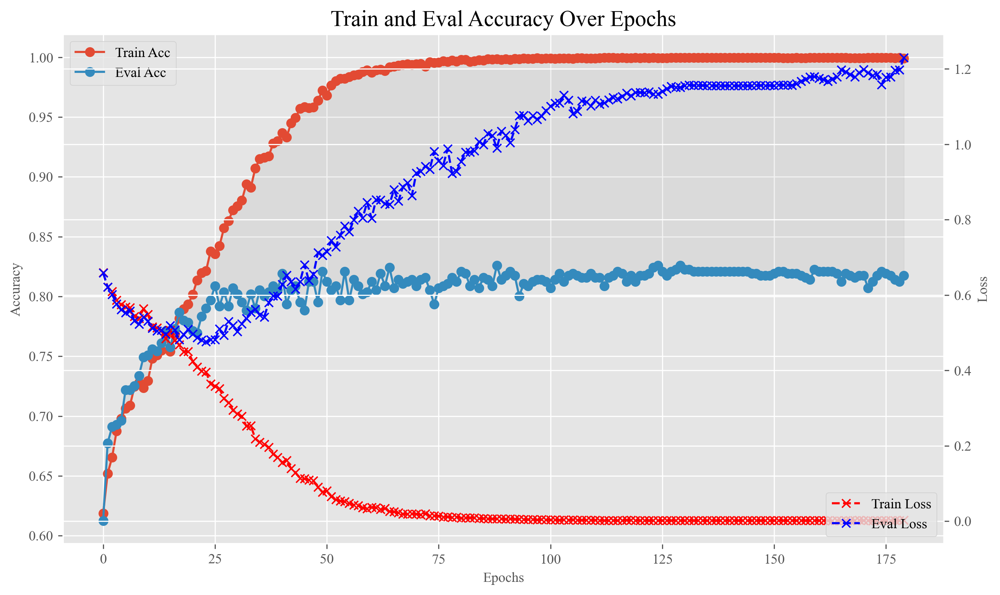

[I 2024-04-29 21:14:46,957] Trial 33 finished with value: 0.825938566552901 and parameters: {'num_blocks': 3, 'dropout': 0.14496744836895242, 'purns': 0.2070090360434076, 'lr': 5.550242519390122e-05, 'epochs': 180}. Best is trial 33 with value: 0.825938566552901.


  0%|          | 0/170 [00:00<?, ?it/s]

train_acc0.5915332891372289  eval_acc0.6023890784982935
train_acc0.6465574391514348  eval_acc0.643344709897611
train_acc0.6632256842504025  eval_acc0.6808873720136519
train_acc0.6871862865801686  eval_acc0.6996587030716723
train_acc0.6968462922625248  eval_acc0.7167235494880546
train_acc0.6877545222085425  eval_acc0.7133105802047781
train_acc0.7030021782365754  eval_acc0.7184300341296929
train_acc0.7193863055213562  eval_acc0.7201365187713311
train_acc0.7238374846102851  eval_acc0.7474402730375427
train_acc0.7314139596552703  eval_acc0.7303754266211604
train_acc0.7395586703286297  eval_acc0.7337883959044369
train_acc0.7442939672317455  eval_acc0.7491467576791809
train_acc0.7482716166303627  eval_acc0.7559726962457338
train_acc0.7530069135334786  eval_acc0.7593856655290102
train_acc0.7696751586324463  eval_acc0.764505119453925
train_acc0.7754522208542476  eval_acc0.7747440273037542
train_acc0.7757363386684345  eval_acc0.7679180887372014
train_acc0.7820816365186097  eval_acc0.77474402730

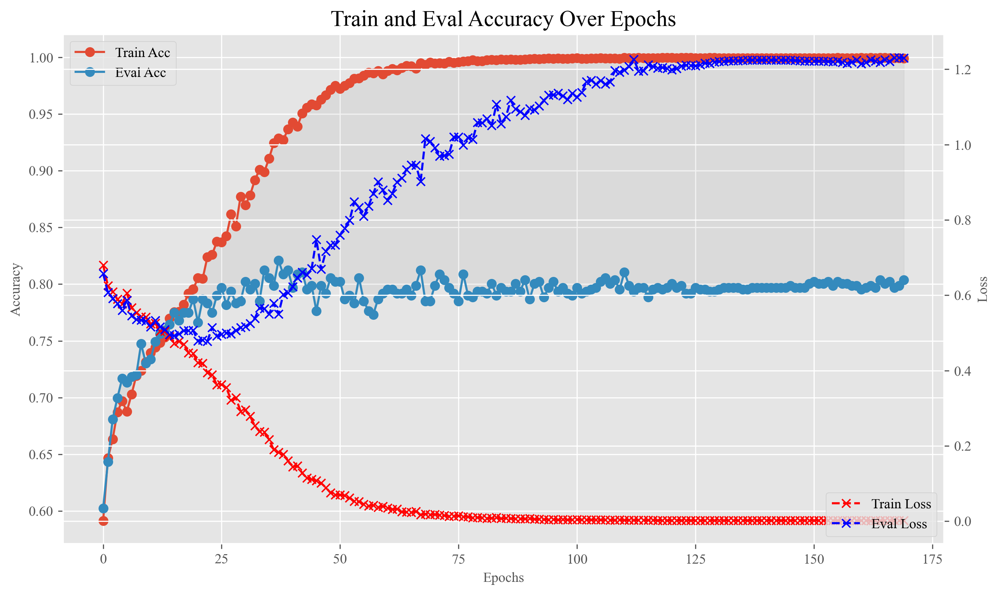

[I 2024-04-29 21:48:36,419] Trial 34 finished with value: 0.8208191126279863 and parameters: {'num_blocks': 3, 'dropout': 0.14674469342836896, 'purns': 0.23529746482949368, 'lr': 5.5600502279611684e-05, 'epochs': 170}. Best is trial 33 with value: 0.825938566552901.


  0%|          | 0/167 [00:00<?, ?it/s]

train_acc0.5804526943839379  eval_acc0.5836177474402731
train_acc0.6377497869116393  eval_acc0.6621160409556314
train_acc0.6700445117908893  eval_acc0.6945392491467577
train_acc0.6820721659248035  eval_acc0.7201365187713311
train_acc0.6952362913154655  eval_acc0.7150170648464164
train_acc0.7023392366701392  eval_acc0.7167235494880546
train_acc0.7121886542286201  eval_acc0.7286689419795221
train_acc0.7099157117151246  eval_acc0.7098976109215017
train_acc0.7302774883985226  eval_acc0.7286689419795221
train_acc0.7306563121507719  eval_acc0.7337883959044369
train_acc0.7160715976891752  eval_acc0.7252559726962458
train_acc0.716639833317549  eval_acc0.735494880546075
train_acc0.7467563216213656  eval_acc0.7508532423208191
train_acc0.7525333838431669  eval_acc0.7542662116040956
train_acc0.7484610285064873  eval_acc0.7508532423208191
train_acc0.7705275120750071  eval_acc0.7542662116040956
train_acc0.7813239890141112  eval_acc0.7662116040955631
train_acc0.7853963443507908  eval_acc0.76791808873

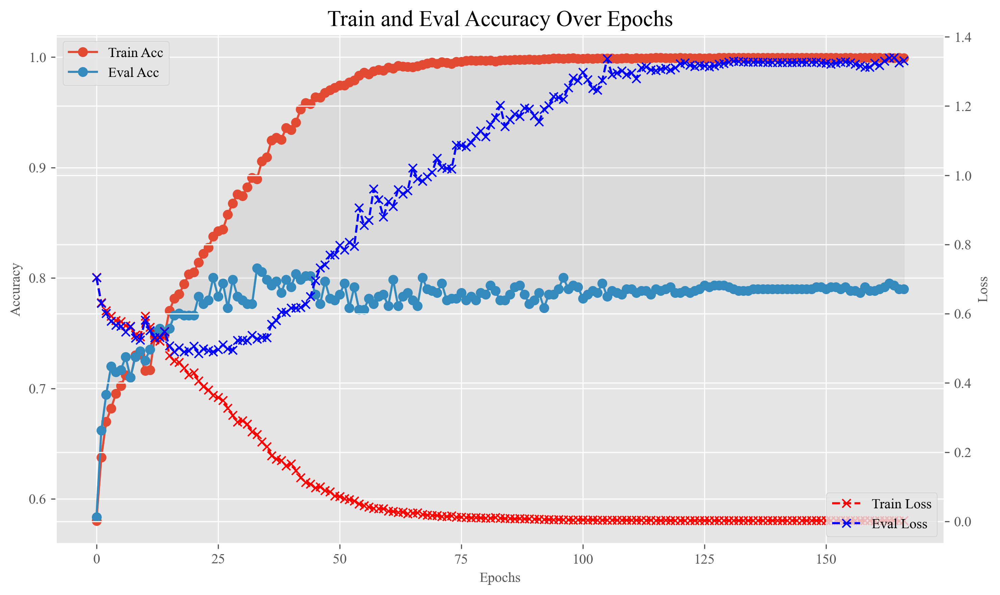

[I 2024-04-29 22:31:09,145] Trial 35 finished with value: 0.8088737201365188 and parameters: {'num_blocks': 3, 'dropout': 0.14658905065836597, 'purns': 0.2022351563506825, 'lr': 5.555354558529543e-05, 'epochs': 167}. Best is trial 33 with value: 0.825938566552901.


  0%|          | 0/172 [00:00<?, ?it/s]

train_acc0.5988256463680273  eval_acc0.60580204778157
train_acc0.6389809641064494  eval_acc0.674061433447099
train_acc0.673548631499195  eval_acc0.689419795221843
train_acc0.6891751112794772  eval_acc0.7047781569965871
train_acc0.6951415853774031  eval_acc0.7064846416382252
train_acc0.7010133535372668  eval_acc0.7252559726962458
train_acc0.7201439530258548  eval_acc0.7372013651877133
train_acc0.7272468983805285  eval_acc0.7337883959044369
train_acc0.7289516052656502  eval_acc0.7320819112627986
train_acc0.7431574959749976  eval_acc0.7542662116040956
train_acc0.7499763235154844  eval_acc0.7525597269624573
train_acc0.7414527890898759  eval_acc0.7457337883959044
train_acc0.7552798560469741  eval_acc0.7491467576791809
train_acc0.7569845629320958  eval_acc0.7627986348122867
train_acc0.7813239890141112  eval_acc0.7662116040955631
train_acc0.7758310446064969  eval_acc0.7525597269624573
train_acc0.7758310446064969  eval_acc0.7747440273037542
train_acc0.7882375224926603  eval_acc0.77815699658703

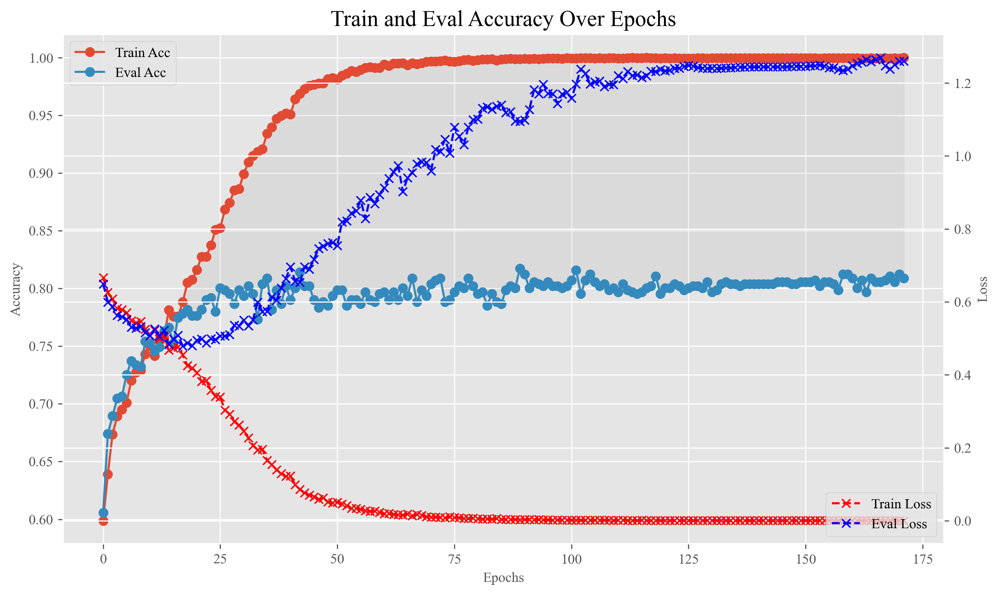

[I 2024-04-29 23:10:00,922] Trial 36 finished with value: 0.8174061433447098 and parameters: {'num_blocks': 3, 'dropout': 0.12786781038716213, 'purns': 0.2502295474889322, 'lr': 5.5833710271540875e-05, 'epochs': 172}. Best is trial 33 with value: 0.825938566552901.


  0%|          | 0/146 [00:00<?, ?it/s]

train_acc0.5844303437825552  eval_acc0.552901023890785
train_acc0.6406856709915711  eval_acc0.6450511945392492
train_acc0.6721280424282603  eval_acc0.7047781569965871
train_acc0.6840609906241122  eval_acc0.6979522184300341
train_acc0.6860498153234208  eval_acc0.7064846416382252
train_acc0.7076427692016289  eval_acc0.7013651877133106
train_acc0.7107680651576854  eval_acc0.7218430034129693
train_acc0.7186286580168576  eval_acc0.7252559726962458
train_acc0.729803958708211  eval_acc0.7303754266211604
train_acc0.7276257221327778  eval_acc0.726962457337884
train_acc0.7374751396912587  eval_acc0.7542662116040956
train_acc0.7454304384884932  eval_acc0.7508532423208191
train_acc0.7515863244625438  eval_acc0.7696245733788396
train_acc0.7632351548442088  eval_acc0.7662116040955631
train_acc0.7689175111279477  eval_acc0.773037542662116
train_acc0.7834075196514821  eval_acc0.7764505119453925
train_acc0.7889951699971588  eval_acc0.78839590443686
train_acc0.7916469362629037  eval_acc0.790102389078498

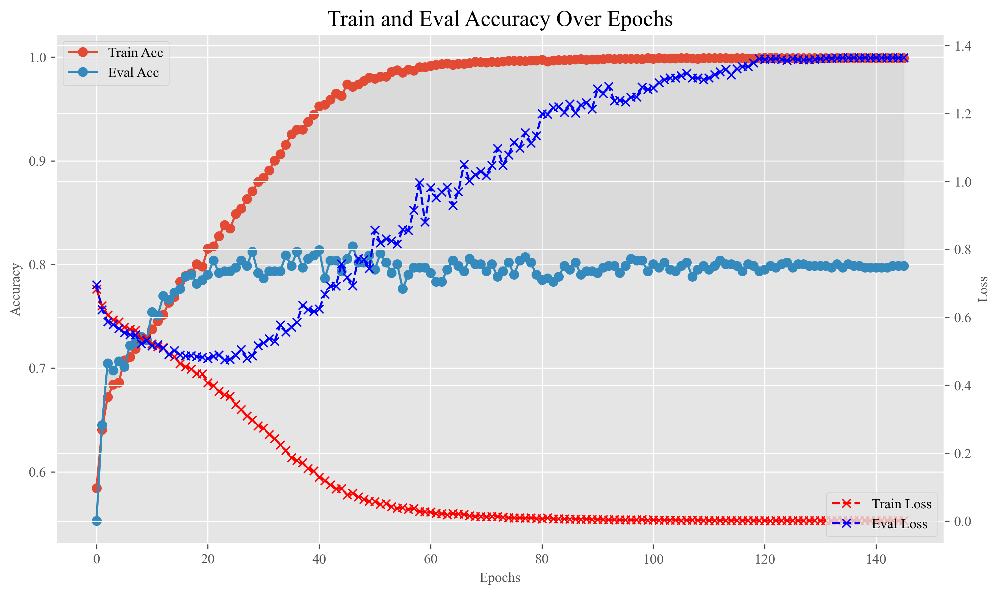

[I 2024-04-30 00:30:38,839] Trial 37 finished with value: 0.8174061433447098 and parameters: {'num_blocks': 4, 'dropout': 0.10894875384181431, 'purns': 0.21255079192219917, 'lr': 3.977797716063595e-05, 'epochs': 146}. Best is trial 33 with value: 0.825938566552901.


  0%|          | 0/158 [00:00<?, ?it/s]

train_acc0.6192821289894876  eval_acc0.6296928327645052
train_acc0.6563121507718533  eval_acc0.6655290102389079
train_acc0.6654986267638981  eval_acc0.6945392491467577
train_acc0.6876598162704801  eval_acc0.6979522184300341
train_acc0.7004451179088929  eval_acc0.7150170648464164
train_acc0.7082110048300029  eval_acc0.7337883959044369
train_acc0.7176815986362345  eval_acc0.7252559726962458
train_acc0.7235533667960982  eval_acc0.7286689419795221
train_acc0.7319821952836443  eval_acc0.735494880546075
train_acc0.7349180793635761  eval_acc0.7542662116040956
train_acc0.7488398522587366  eval_acc0.742320819112628
train_acc0.755848091675348  eval_acc0.7542662116040956
train_acc0.7585945638791552  eval_acc0.757679180887372
train_acc0.7487451463206743  eval_acc0.7406143344709898
train_acc0.765129273605455  eval_acc0.7610921501706485
train_acc0.7791457524386779  eval_acc0.7593856655290102
train_acc0.7834075196514821  eval_acc0.7798634812286689
train_acc0.795340467847334  eval_acc0.767918088737201

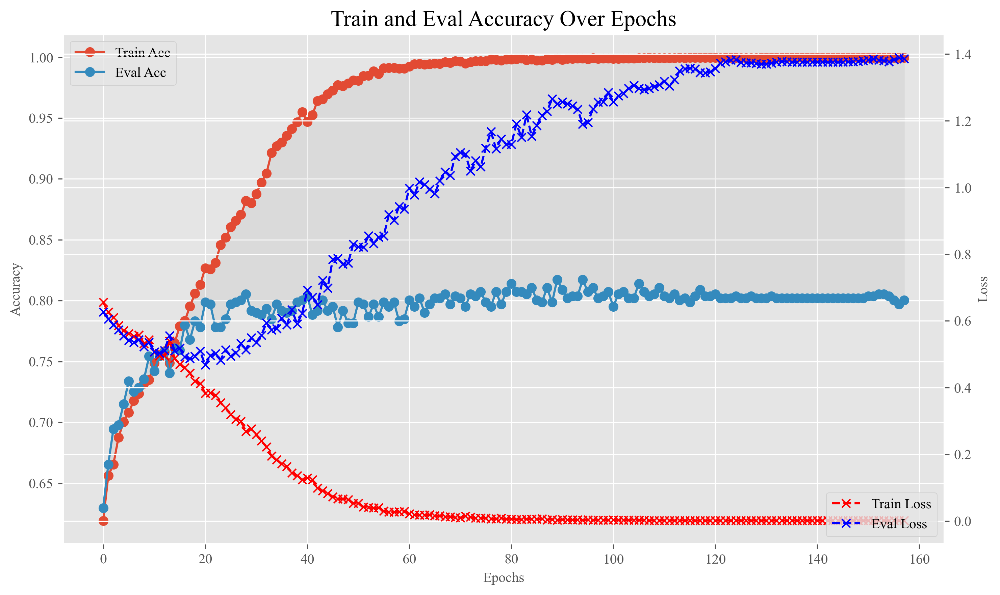

[I 2024-04-30 02:06:10,346] Trial 38 finished with value: 0.8174061433447098 and parameters: {'num_blocks': 4, 'dropout': 0.13624430188541467, 'purns': 0.22117892829536864, 'lr': 5.929727996091646e-05, 'epochs': 158}. Best is trial 33 with value: 0.825938566552901.


  0%|          | 0/188 [00:00<?, ?it/s]

train_acc0.6035609432711431  eval_acc0.6006825938566553
train_acc0.630173311866654  eval_acc0.6484641638225256
train_acc0.6677715692773937  eval_acc0.6911262798634812
train_acc0.6774315749597499  eval_acc0.7167235494880546
train_acc0.6914480537929728  eval_acc0.7167235494880546
train_acc0.6976986457050857  eval_acc0.726962457337884
train_acc0.7010133535372668  eval_acc0.7184300341296929
train_acc0.7191968936452315  eval_acc0.7406143344709898
train_acc0.7246898380528459  eval_acc0.7372013651877133
train_acc0.7302774883985226  eval_acc0.7457337883959044
train_acc0.7352969031158254  eval_acc0.7457337883959044
train_acc0.744767496922057  eval_acc0.7679180887372014
train_acc0.7449569087981817  eval_acc0.757679180887372
train_acc0.756132209489535  eval_acc0.7713310580204779
train_acc0.7594469173217161  eval_acc0.7679180887372014
train_acc0.7688228051898854  eval_acc0.773037542662116
train_acc0.7747892792878114  eval_acc0.7747440273037542
train_acc0.7796192821289895  eval_acc0.769624573378839

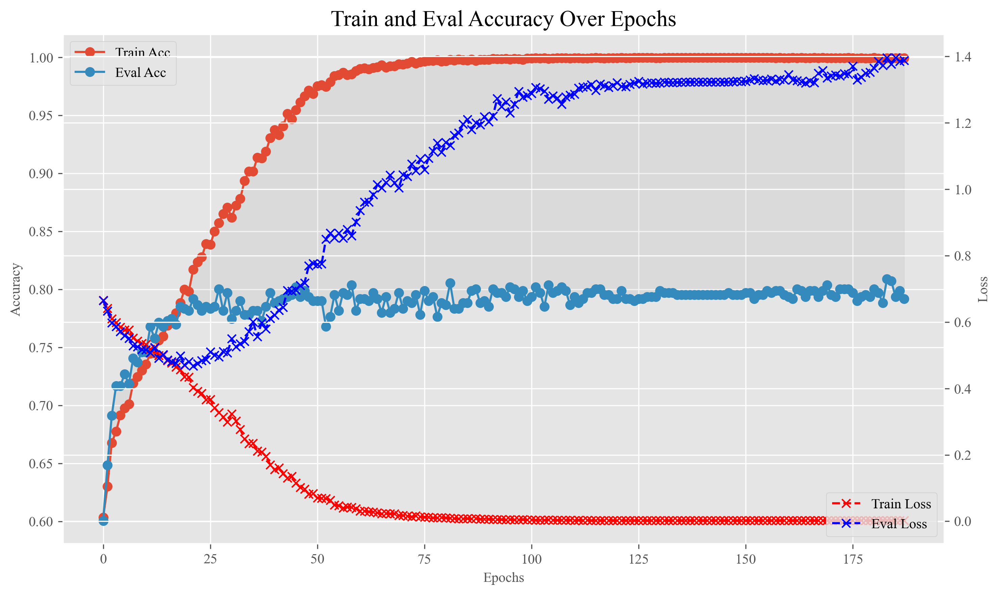

[I 2024-04-30 02:44:50,907] Trial 39 finished with value: 0.8088737201365188 and parameters: {'num_blocks': 3, 'dropout': 0.11972793563097063, 'purns': 0.23750116091232806, 'lr': 3.986999343374241e-05, 'epochs': 188}. Best is trial 33 with value: 0.825938566552901.


  0%|          | 0/162 [00:00<?, ?it/s]

train_acc0.5948479969694099  eval_acc0.60580204778157
train_acc0.6405909650535089  eval_acc0.643344709897611
train_acc0.6726962780566341  eval_acc0.6945392491467577
train_acc0.6848186381286107  eval_acc0.6877133105802048
train_acc0.6940051141206554  eval_acc0.7098976109215017
train_acc0.7100104176531868  eval_acc0.7201365187713311
train_acc0.7138933611137418  eval_acc0.7337883959044369
train_acc0.7200492470877924  eval_acc0.7167235494880546
train_acc0.7228904252296618  eval_acc0.7235494880546075
train_acc0.7284780755753386  eval_acc0.7406143344709898
train_acc0.7309404299649588  eval_acc0.7440273037542662
train_acc0.725636897433469  eval_acc0.7440273037542662
train_acc0.7435363197272469  eval_acc0.7406143344709898
train_acc0.7626669192158348  eval_acc0.7525597269624573
train_acc0.7709063358272563  eval_acc0.7610921501706485
train_acc0.7787669286864286  eval_acc0.7662116040955631
train_acc0.77677810398712  eval_acc0.7696245733788396
train_acc0.7928781134577138  eval_acc0.769624573378839

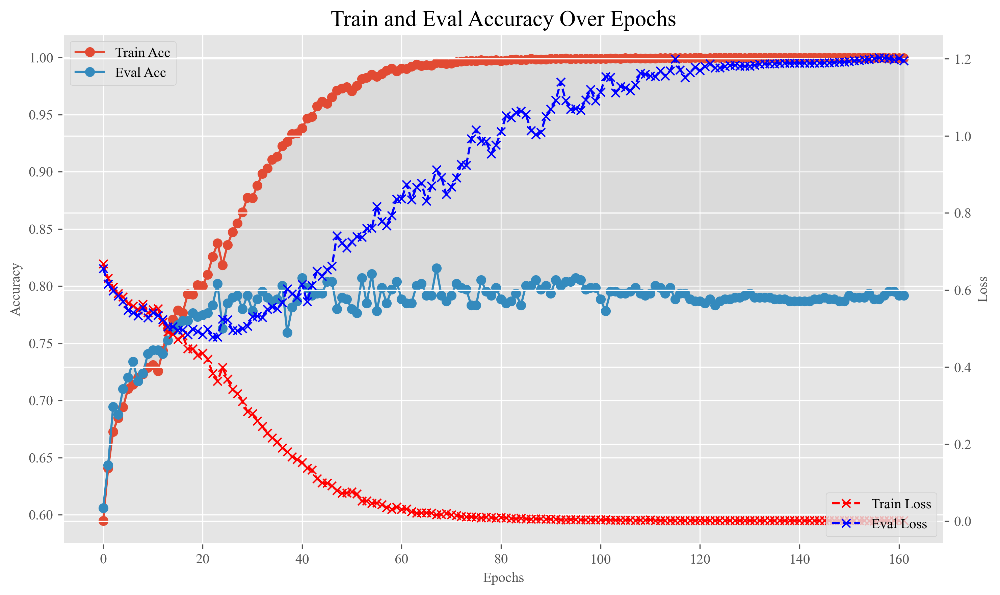

[I 2024-04-30 05:38:14,075] Trial 40 finished with value: 0.8156996587030717 and parameters: {'num_blocks': 4, 'dropout': 0.15000508329520154, 'purns': 0.20276893185924053, 'lr': 5.359458001585673e-05, 'epochs': 162}. Best is trial 33 with value: 0.825938566552901.


  0%|          | 0/174 [00:00<?, ?it/s]

train_acc0.5872715219244247  eval_acc0.6006825938566553
train_acc0.6333933137607728  eval_acc0.6399317406143344
train_acc0.6610474476749693  eval_acc0.689419795221843
train_acc0.6803674590396818  eval_acc0.7098976109215017
train_acc0.698077469457335  eval_acc0.7064846416382252
train_acc0.7047068851216971  eval_acc0.726962457337884
train_acc0.7178710105123591  eval_acc0.7389078498293515
train_acc0.7174921867601098  eval_acc0.742320819112628
train_acc0.7290463112037124  eval_acc0.742320819112628
train_acc0.7260157211857183  eval_acc0.7406143344709898
train_acc0.7413580831518136  eval_acc0.7508532423208191
train_acc0.7386116109480064  eval_acc0.7508532423208191
train_acc0.7506392650819206  eval_acc0.7525597269624573
train_acc0.7500710294535468  eval_acc0.7440273037542662
train_acc0.7732739842788143  eval_acc0.7696245733788396
train_acc0.7807557533857373  eval_acc0.7764505119453925
train_acc0.7856804621649778  eval_acc0.7781569965870307
train_acc0.7985604697414528  eval_acc0.77303754266211

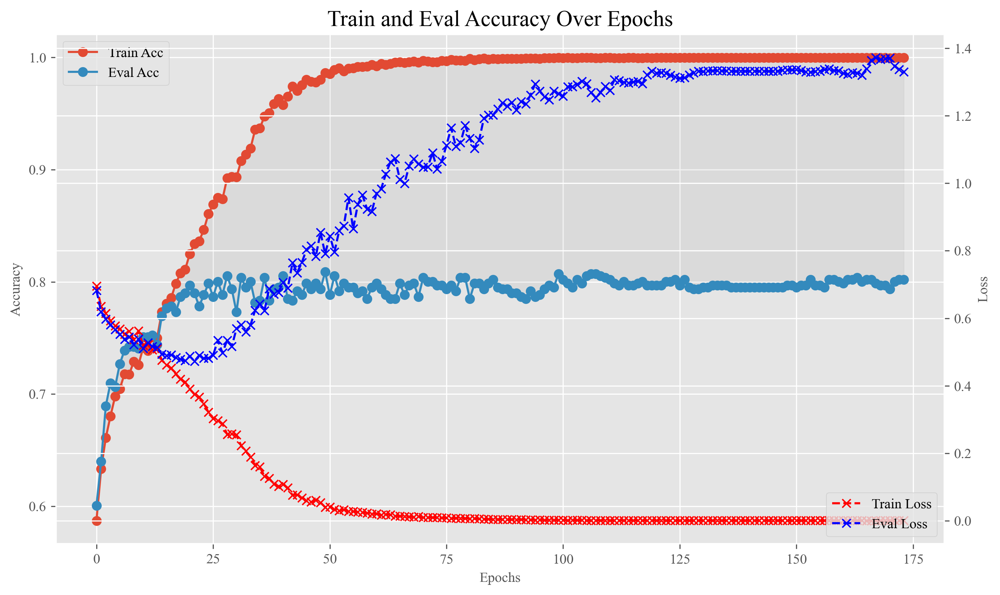

[I 2024-04-30 06:44:51,440] Trial 41 finished with value: 0.8088737201365188 and parameters: {'num_blocks': 3, 'dropout': 0.12642071193749466, 'purns': 0.2534170716321559, 'lr': 6.305281609576663e-05, 'epochs': 174}. Best is trial 33 with value: 0.825938566552901.


  0%|          | 0/171 [00:00<?, ?it/s]

train_acc0.5915332891372289  eval_acc0.6177474402730375
train_acc0.6386968462922625  eval_acc0.6399317406143344
train_acc0.6705180414812009  eval_acc0.689419795221843
train_acc0.6725068661805095  eval_acc0.7047781569965871
train_acc0.6937209963064684  eval_acc0.7201365187713311
train_acc0.6990245288379582  eval_acc0.7389078498293515
train_acc0.7101998295293115  eval_acc0.735494880546075
train_acc0.722038071787101  eval_acc0.735494880546075
train_acc0.7178710105123591  eval_acc0.7457337883959044
train_acc0.733686902168766  eval_acc0.7559726962457338
train_acc0.7367174921867601  eval_acc0.7406143344709898
train_acc0.7420210247182498  eval_acc0.7474402730375427
train_acc0.748650440382612  eval_acc0.773037542662116
train_acc0.7553745619850365  eval_acc0.742320819112628
train_acc0.7728004545885027  eval_acc0.7696245733788396
train_acc0.7687280992518231  eval_acc0.7696245733788396
train_acc0.7739369258452505  eval_acc0.7747440273037542
train_acc0.7783881049341794  eval_acc0.7713310580204779


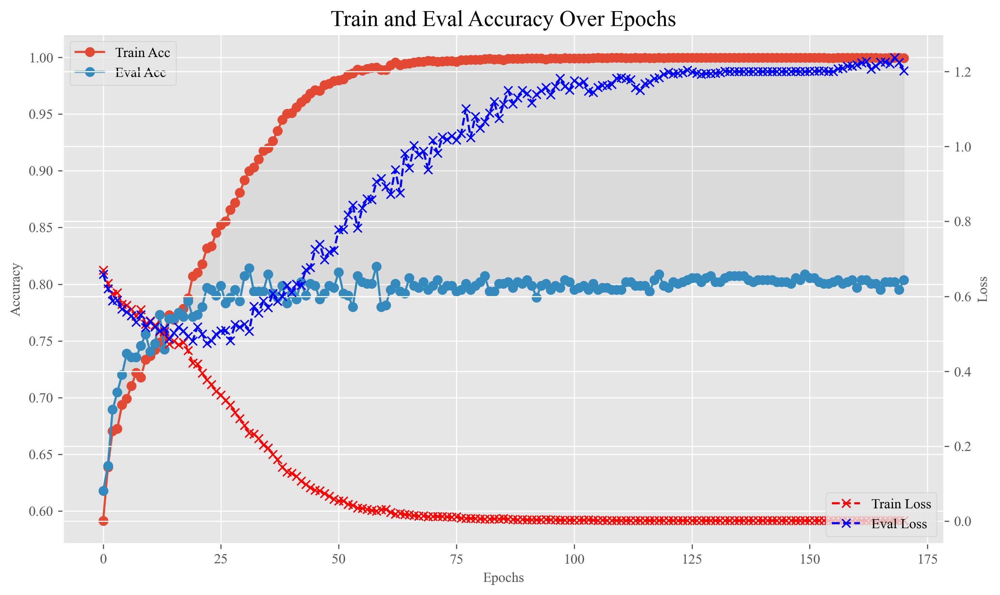

[I 2024-04-30 08:55:56,276] Trial 42 finished with value: 0.8156996587030717 and parameters: {'num_blocks': 3, 'dropout': 0.13022048053599083, 'purns': 0.2375964482008926, 'lr': 5.315946236685729e-05, 'epochs': 171}. Best is trial 33 with value: 0.825938566552901.


  0%|          | 0/200 [00:00<?, ?it/s]

train_acc0.5494838526375604  eval_acc0.5750853242320819
train_acc0.6238280140164788  eval_acc0.6399317406143344
train_acc0.6636992139407141  eval_acc0.6911262798634812
train_acc0.6724121602424472  eval_acc0.6877133105802048
train_acc0.68519746188086  eval_acc0.7013651877133106
train_acc0.698361587271522  eval_acc0.7064846416382252
train_acc0.7084004167061275  eval_acc0.7184300341296929
train_acc0.7142721848659911  eval_acc0.7235494880546075
train_acc0.7247845439909082  eval_acc0.726962457337884
train_acc0.7360545506203239  eval_acc0.7389078498293515
train_acc0.7452410266123686  eval_acc0.7457337883959044
train_acc0.7496922057012975  eval_acc0.7508532423208191
train_acc0.7607728004545885  eval_acc0.7627986348122867
train_acc0.7675916279950753  eval_acc0.7610921501706485
train_acc0.77677810398712  eval_acc0.7713310580204779
train_acc0.7818922246424851  eval_acc0.757679180887372
train_acc0.7919310540770906  eval_acc0.7662116040955631
train_acc0.7988445875556397  eval_acc0.7781569965870307

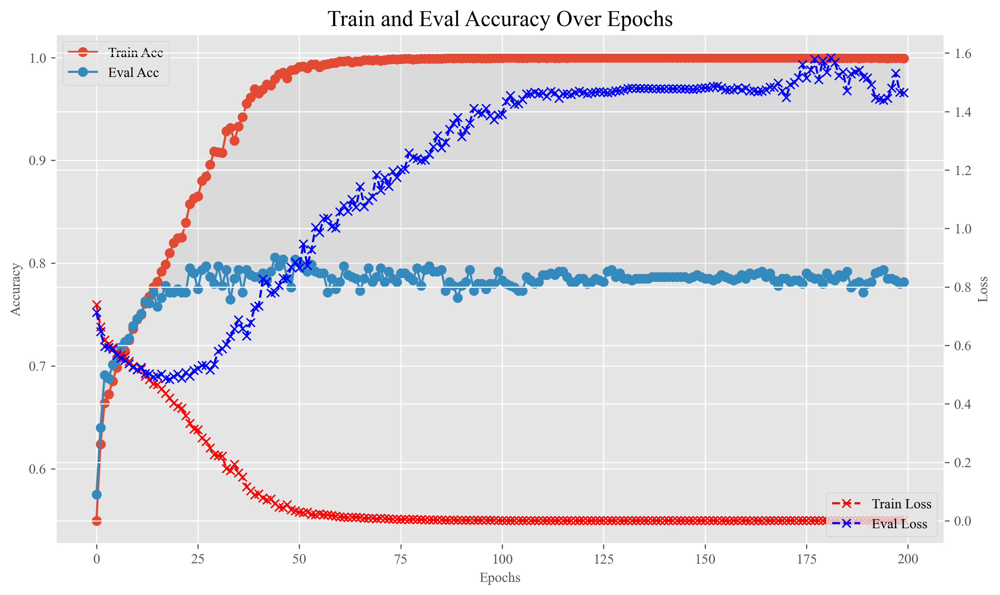

[I 2024-04-30 10:58:56,839] Trial 43 finished with value: 0.8054607508532423 and parameters: {'num_blocks': 3, 'dropout': 0.10776012096192253, 'purns': 0.2521475422553118, 'lr': 6.0170405001289173e-05, 'epochs': 200}. Best is trial 33 with value: 0.825938566552901.


  0%|          | 0/185 [00:00<?, ?it/s]

train_acc0.5772326924898191  eval_acc0.5648464163822525
train_acc0.637939198787764  eval_acc0.6399317406143344
train_acc0.6783786343403732  eval_acc0.7081911262798635
train_acc0.6865233450137324  eval_acc0.7030716723549488
train_acc0.6994980585282697  eval_acc0.7167235494880546
train_acc0.7027180604223885  eval_acc0.7218430034129693
train_acc0.7123780661047447  eval_acc0.7303754266211604
train_acc0.7243110143005966  eval_acc0.7406143344709898
train_acc0.7288568993275878  eval_acc0.7372013651877133
train_acc0.7293304290178995  eval_acc0.7372013651877133
train_acc0.7433469078511222  eval_acc0.7542662116040956
train_acc0.7524386779051047  eval_acc0.7593856655290102
train_acc0.7530069135334786  eval_acc0.7627986348122867
train_acc0.763898096410645  eval_acc0.7593856655290102
train_acc0.7760204564826214  eval_acc0.757679180887372
train_acc0.7739369258452505  eval_acc0.7662116040955631
train_acc0.7861539918552893  eval_acc0.773037542662116
train_acc0.7912681125106544  eval_acc0.7645051194539

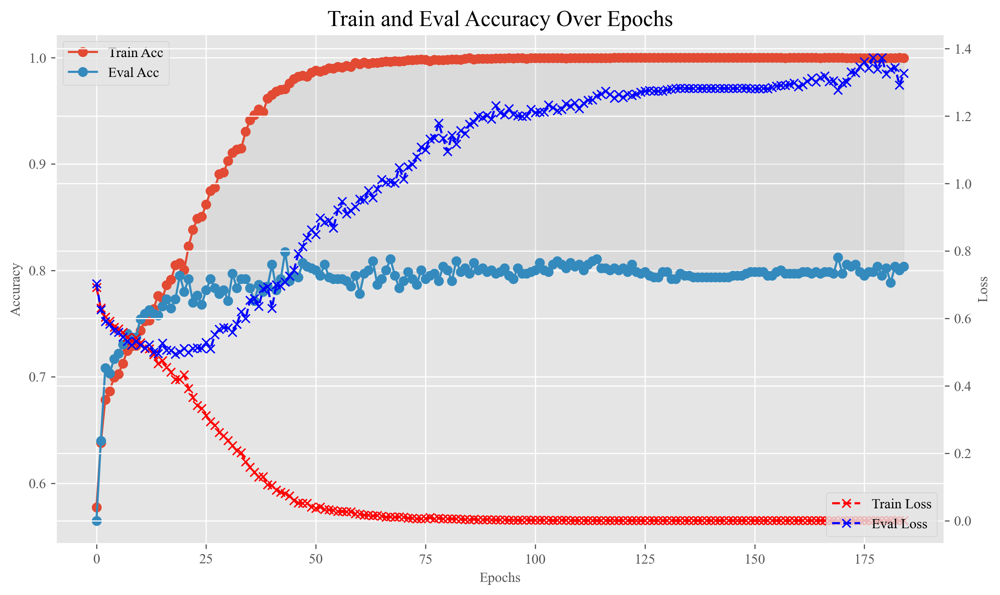

[I 2024-04-30 11:27:12,605] Trial 44 finished with value: 0.8174061433447098 and parameters: {'num_blocks': 2, 'dropout': 0.12102866881015305, 'purns': 0.21763763948197298, 'lr': 6.764331202888778e-05, 'epochs': 185}. Best is trial 33 with value: 0.825938566552901.


  0%|          | 0/194 [00:00<?, ?it/s]

train_acc0.5545979732929255  eval_acc0.5716723549488054
train_acc0.6293209584240932  eval_acc0.6194539249146758
train_acc0.6583956814092243  eval_acc0.6791808873720137
train_acc0.6703286296050762  eval_acc0.6962457337883959
train_acc0.6827351074912397  eval_acc0.7098976109215017
train_acc0.6856709915711715  eval_acc0.7167235494880546
train_acc0.7022445307320769  eval_acc0.7184300341296929
train_acc0.7086845345203144  eval_acc0.7303754266211604
train_acc0.714556302680178  eval_acc0.7389078498293515
train_acc0.7193863055213562  eval_acc0.7372013651877133
train_acc0.7232692489819111  eval_acc0.742320819112628
train_acc0.7326451368500805  eval_acc0.735494880546075
train_acc0.7377592575054456  eval_acc0.7593856655290102
train_acc0.7459039681788048  eval_acc0.757679180887372
train_acc0.7430627900369353  eval_acc0.7491467576791809
train_acc0.7461880859929918  eval_acc0.7542662116040956
train_acc0.7571739748082205  eval_acc0.7542662116040956
train_acc0.7663604508002652  eval_acc0.7542662116040

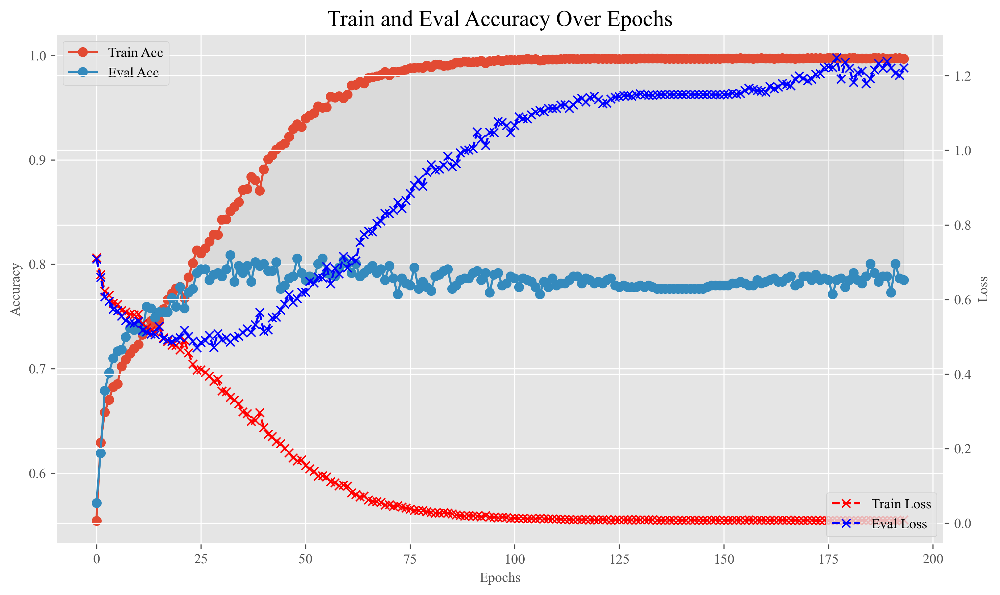

[I 2024-04-30 13:18:07,103] Trial 45 finished with value: 0.8088737201365188 and parameters: {'num_blocks': 3, 'dropout': 0.15902093088123542, 'purns': 0.23239155703340236, 'lr': 4.1768587962145195e-05, 'epochs': 194}. Best is trial 33 with value: 0.825938566552901.


  0%|          | 0/154 [00:00<?, ?it/s]

train_acc0.5980679988635288  eval_acc0.6160409556313993
train_acc0.632256842504025  eval_acc0.6348122866894198
train_acc0.6605739179846576  eval_acc0.6911262798634812
train_acc0.6772421630836254  eval_acc0.6877133105802048
train_acc0.6776209868358746  eval_acc0.6860068259385665
train_acc0.6946680556870916  eval_acc0.7133105802047781
train_acc0.7006345297850175  eval_acc0.7081911262798635
train_acc0.7094421820248129  eval_acc0.7201365187713311
train_acc0.7122833601666825  eval_acc0.7098976109215017
train_acc0.7246898380528459  eval_acc0.7286689419795221
train_acc0.730372194336585  eval_acc0.7252559726962458
train_acc0.7377592575054456  eval_acc0.7372013651877133
train_acc0.7425892603466238  eval_acc0.7474402730375427
train_acc0.7425892603466238  eval_acc0.742320819112628
train_acc0.7477033810019889  eval_acc0.7474402730375427
train_acc0.7603939767023392  eval_acc0.757679180887372
train_acc0.767212804242826  eval_acc0.7610921501706485
train_acc0.7712851595795056  eval_acc0.76109215017064

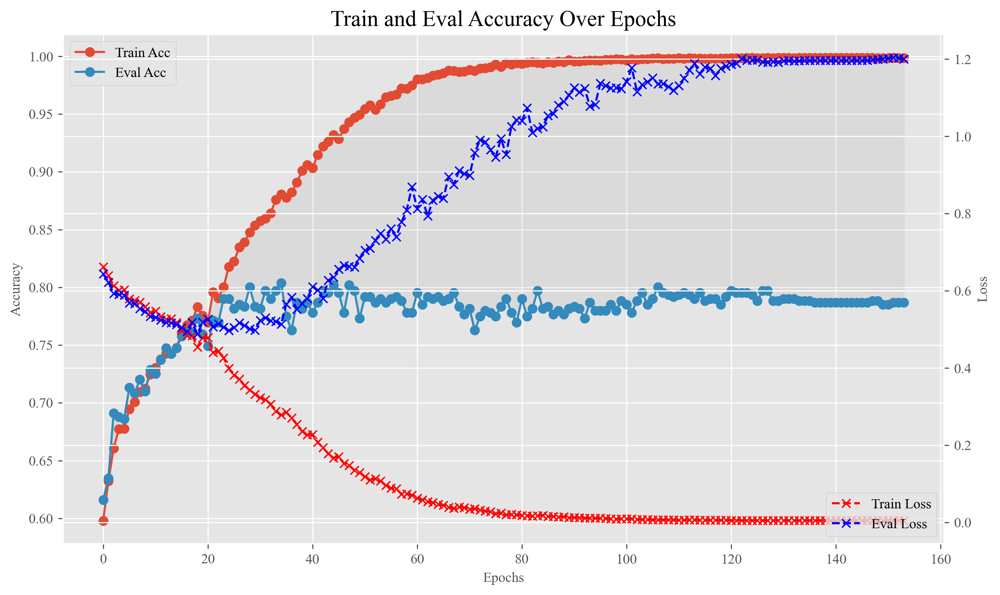

[I 2024-04-30 15:27:58,156] Trial 46 finished with value: 0.8037542662116041 and parameters: {'num_blocks': 4, 'dropout': 0.14046989204833668, 'purns': 0.24712969540743543, 'lr': 3.588603725925803e-05, 'epochs': 154}. Best is trial 33 with value: 0.825938566552901.


  0%|          | 0/146 [00:00<?, ?it/s]

train_acc0.5611326830192253  eval_acc0.5255972696245734
train_acc0.6207974239984847  eval_acc0.6143344709897611
train_acc0.6662562742683966  eval_acc0.6757679180887372
train_acc0.681314518420305  eval_acc0.6860068259385665
train_acc0.6950468794393408  eval_acc0.7098976109215017
train_acc0.6974145278908987  eval_acc0.726962457337884
train_acc0.7089686523345013  eval_acc0.7167235494880546
train_acc0.7165451273794867  eval_acc0.7303754266211604
train_acc0.7179657164504214  eval_acc0.7303754266211604
train_acc0.7245004261767213  eval_acc0.735494880546075
train_acc0.7341604318590775  eval_acc0.7389078498293515
train_acc0.7421157306563122  eval_acc0.7508532423208191
train_acc0.7452410266123686  eval_acc0.7559726962457338
train_acc0.7446727909839947  eval_acc0.764505119453925
train_acc0.7552798560469741  eval_acc0.757679180887372
train_acc0.7642769201628942  eval_acc0.7713310580204779
train_acc0.771379865517568  eval_acc0.7662116040955631
train_acc0.7778198693058055  eval_acc0.778156996587030

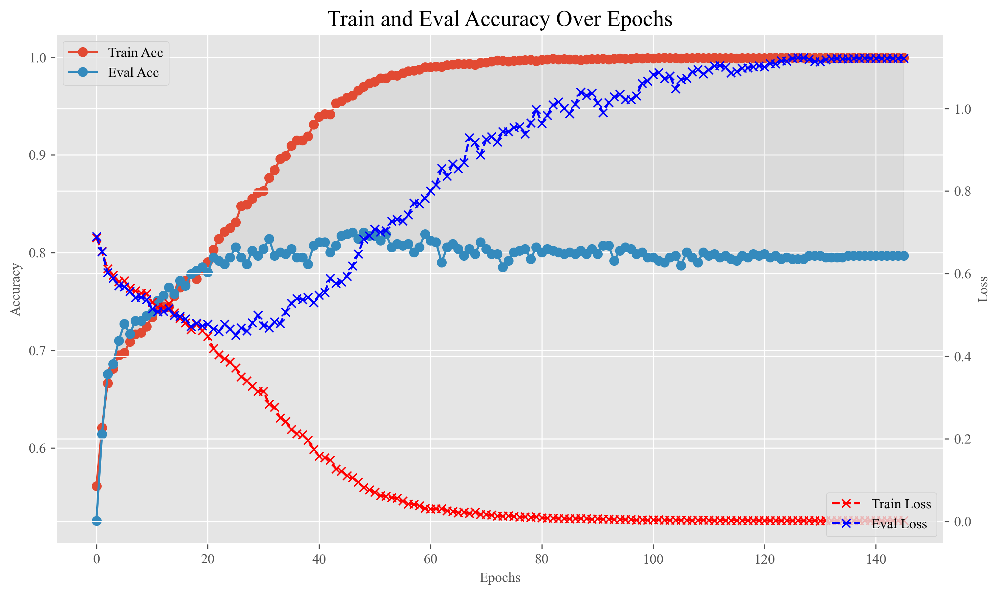

[I 2024-04-30 15:48:51,639] Trial 47 finished with value: 0.8208191126279863 and parameters: {'num_blocks': 2, 'dropout': 0.1157920463390984, 'purns': 0.20522439200964845, 'lr': 4.956812511359316e-05, 'epochs': 146}. Best is trial 33 with value: 0.825938566552901.


  0%|          | 0/143 [00:00<?, ?it/s]

train_acc0.5711715124538309  eval_acc0.5989761092150171
train_acc0.6296997821763425  eval_acc0.6313993174061433
train_acc0.6647409792593996  eval_acc0.6843003412969283
train_acc0.6737380433753196  eval_acc0.6928327645051194
train_acc0.6911639359787859  eval_acc0.6979522184300341
train_acc0.697793351643148  eval_acc0.7047781569965871
train_acc0.7020551188559523  eval_acc0.7184300341296929
train_acc0.7094421820248129  eval_acc0.7320819112627986
train_acc0.7178710105123591  eval_acc0.726962457337884
train_acc0.7264892508760299  eval_acc0.7337883959044369
train_acc0.7309404299649588  eval_acc0.757679180887372
train_acc0.7340657259210153  eval_acc0.7491467576791809
train_acc0.7421157306563122  eval_acc0.7457337883959044
train_acc0.7518704422767307  eval_acc0.7559726962457338
train_acc0.7555639738611611  eval_acc0.7593856655290102
train_acc0.7650345676673928  eval_acc0.7696245733788396
train_acc0.7692016289421346  eval_acc0.7764505119453925
train_acc0.7705275120750071  eval_acc0.761092150170

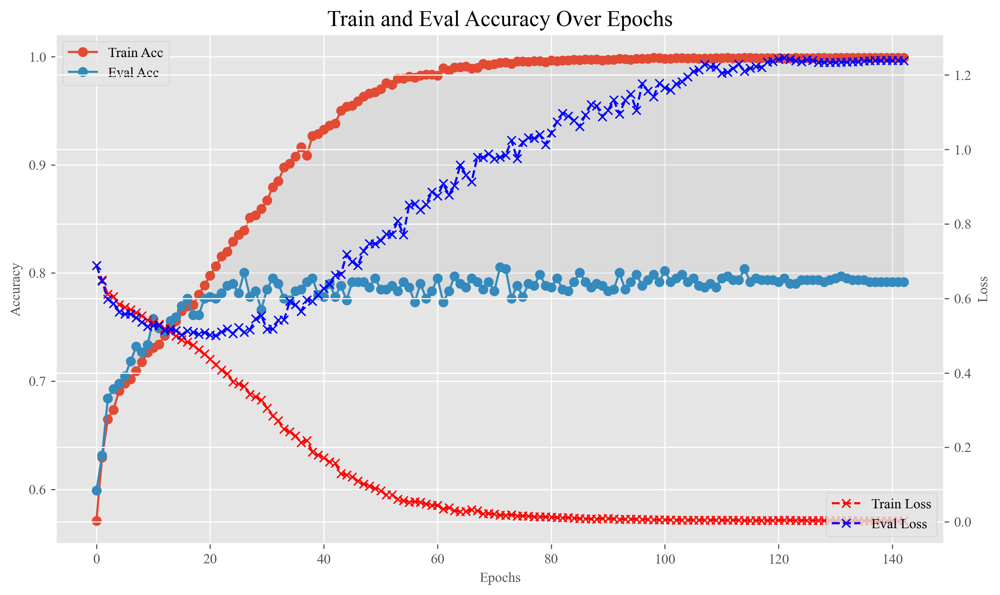

[I 2024-04-30 16:11:09,844] Trial 48 finished with value: 0.8054607508532423 and parameters: {'num_blocks': 2, 'dropout': 0.11491076540517069, 'purns': 0.18968046599169594, 'lr': 4.752568995604731e-05, 'epochs': 143}. Best is trial 33 with value: 0.825938566552901.


  0%|          | 0/148 [00:00<?, ?it/s]

train_acc0.5450326735486315  eval_acc0.5699658703071673
train_acc0.6345297850175206  eval_acc0.6382252559726962
train_acc0.6669192158348328  eval_acc0.6877133105802048
train_acc0.6780945165261862  eval_acc0.689419795221843
train_acc0.6932474666161569  eval_acc0.7133105802047781
train_acc0.7046121791836348  eval_acc0.7150170648464164
train_acc0.7129463017331187  eval_acc0.7252559726962458
train_acc0.714840420494365  eval_acc0.726962457337884
train_acc0.7276257221327778  eval_acc0.7389078498293515
train_acc0.7333080784165167  eval_acc0.7491467576791809
train_acc0.7422104365943745  eval_acc0.7525597269624573
train_acc0.752817501657354  eval_acc0.7662116040955631
train_acc0.7609622123307132  eval_acc0.7679180887372014
train_acc0.7737475139691259  eval_acc0.7713310580204779
train_acc0.7816081068282982  eval_acc0.7662116040955631
train_acc0.7831234018372952  eval_acc0.7747440273037542
train_acc0.7915522303248413  eval_acc0.7798634812286689
train_acc0.7999810588123876  eval_acc0.7849829351535

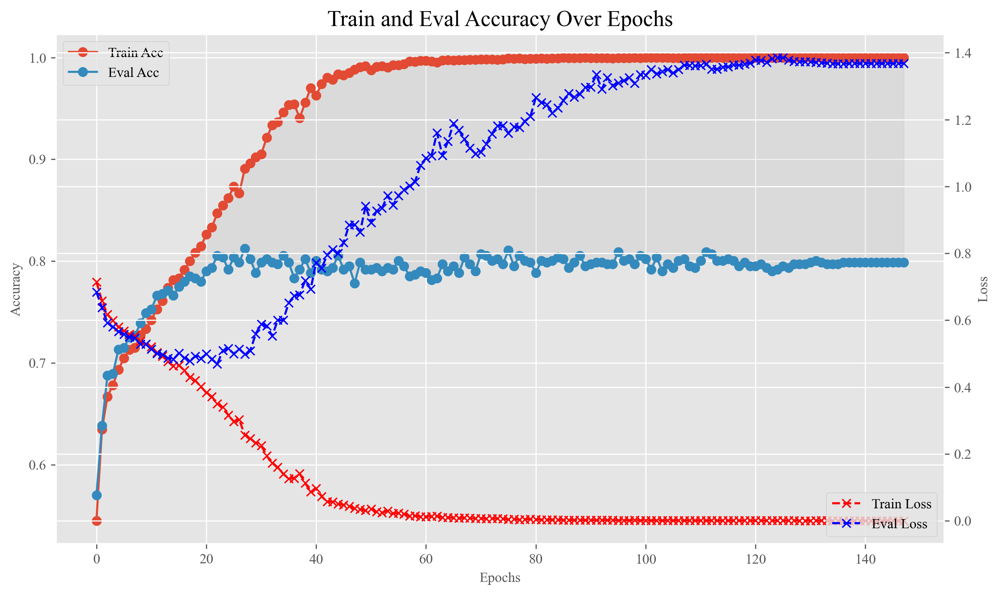

[I 2024-04-30 16:33:41,142] Trial 49 finished with value: 0.8122866894197952 and parameters: {'num_blocks': 2, 'dropout': 0.10218070793073625, 'purns': 0.20552301508933954, 'lr': 6.536570512393844e-05, 'epochs': 148}. Best is trial 33 with value: 0.825938566552901.


Study statistics: 
  Number of finished trials:  50
  Number of pruned trials:  0
  Number of complete trials:  50
Best trial:
  Value:  0.825938566552901
  Params: 
    num_blocks: 3
    dropout: 0.14496744836895242
    purns: 0.2070090360434076
    lr: 5.550242519390122e-05
    epochs: 180


In [15]:
import pickle
from optuna.trial import TrialState

if __name__ == "__main__":
    study = optuna.create_study(direction="maximize")
    study.optimize(objective,n_trials=50)

    pruned_trials = study.get_trials(deepcopy=False, states=[TrialState.PRUNED])
    complete_trials = study.get_trials(deepcopy=False, states=[TrialState.COMPLETE])
    with open('example-study.pkl', 'wb') as f:
        pickle.dump(study, f)
    print("Study statistics: ")
    print("  Number of finished trials: ", len(study.trials))
    print("  Number of pruned trials: ", len(pruned_trials))
    print("  Number of complete trials: ", len(complete_trials))

    print("Best trial:")
    trial = study.best_trial

    print("  Value: ", trial.value)

    print("  Params: ")
    for key, value in trial.params.items():
        print("    {}: {}".format(key, value))

In [24]:
for  lr in [0.1,0.01] :
     scaler = torch.cuda.amp.GradScaler()



In [16]:
# from matplotlib import pyplot as plt
# from tqdm.notebook import tqdm
# import numpy as np
# plt.style.use('ggplot')
# plt.rcParams['font.family'] = 'Times New Roman'
#
# completed_steps = 1
#
# train_accs=[]
# eval_accs=[]
# train_losses=[]
# eval_losses=[]
# best_acc=0.8
# for epoch in tqdm(range(num_train_epochs),total=num_train_epochs):
#
#     model.train()
#     for step,batch in enumerate(train_dataloader):
#
#         labels = batch[item].to(torch.int64)
#
#         logits = model(input_ids=batch['input_ids'],attention_mask=batch['attention_mask']).logits
#
#         loss = criterion(logits, labels)
#
#         loss=loss/gradient_accumulation_steps
#         loss.backward()
#         if step % gradient_accumulation_steps==0:
#             # accelerator.clip_grad_norm_(model.parameters(), 1.0)
#             optimizer.step()
#             lr_scheduler.step()
#             optimizer.zero_grad()
#             completed_steps += 1
#             torch.cuda.empty_cache()
#
#     eval_acc=acc(eval_dataloader,model)
#     train_acc=acc(train_dataloader,model)
#     train_accs.append(train_acc)
#     eval_accs.append(eval_acc)
#
#     train_losse=caculate_loss(train_dataloader,model)
#     eval_losse=caculate_loss(eval_dataloader,model)
#     train_losses.append(train_losse.cpu().numpy())
#     eval_losses.append(eval_losse.cpu().numpy())
#
#     tqdm.write(f'train_acc{train_acc}  eval_acc{eval_acc}')
#     torch.cuda.empty_cache()
#
#     if eval_acc>best_acc:
#         torch.save(model.state_dict(), 'best_val.model')
#         best_val = eval_acc
#
# fig, ax1 = plt.subplots(figsize=(10, 6))
#
# # 绘制 accuracy
# ax1.plot(range(num_train_epochs), train_accs, label='Train Acc', marker='o')
# ax1.plot(range(num_train_epochs), eval_accs, label='Eval Acc', marker='o')
# ax1.fill_between(range(num_train_epochs), train_accs, eval_accs, color='gray', alpha=0.1)
# ax1.set_xlabel('Epochs', fontsize=10)
# ax1.set_ylabel('Accuracy', fontsize=10)
# ax1.set_title('Train and Eval Accuracy Over Epochs', fontsize=16)
# ax1.legend(loc='upper left', fontsize=10)
#
# # 创建第二个 y 轴并绘制 loss
# ax2 = ax1.twinx()
# ax2.plot(range(num_train_epochs), train_losses, label='Train Loss', color='red', linestyle='--', marker='x')
# ax2.plot(range(num_train_epochs), eval_losses, label='Eval Loss', color='blue', linestyle='--', marker='x')
# ax2.set_ylabel('Loss', fontsize=10)
# ax2.legend(loc='lower right', fontsize=10)
#
# plt.grid(True)
# plt.tight_layout()
# plt.gcf().set_dpi(300)
# plt.show()


In [17]:
# model.load_state_dict(torch.load('best_val.model'))